In [1]:
import anndata
import pixelator
import torch
import scvi
import scipy
# from scvi import autotune

import seaborn as sns
import scanpy as sc
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
from tqdm import tqdm

from scib_metrics.benchmark import Benchmarker, BioConservation, BatchCorrection

# import ray
# from ray import tune


from PixelGen.pxl_utils import *
from PixelGen.scvi_utils import plot_losses
from PixelGen.tests import test_convert_edgelist_to_protein_pair_colocalization

from pixelator.plot import molecule_rank_plot, cell_count_plot, scatter_umi_per_upia_vs_tau
from pixelator.statistics import clr_transformation
from pixelator.analysis.normalization import dsb_normalize


import tempfile

from scvi import REGISTRY_KEYS
from scvi.module.base import (
    BaseModuleClass,
    LossOutput,
    PyroBaseModuleClass,
    auto_move_data,
)
from torch.distributions import NegativeBinomial, Normal, Poisson
from torch.distributions import kl_divergence as kl

from PixelGen.modules import MultiModalSCVI
from cytovi import CytoVI

print(torch.cuda.is_available())

%load_ext autoreload
%autoreload 2

scvi.settings.seed = 0
print("Last run with scvi-tools version:", scvi.__version__)
sc.set_figure_params(figsize=(6, 6), frameon=False)
sns.set_theme()
torch.set_float32_matmul_precision("high")
save_dir = tempfile.TemporaryDirectory()

%config InlineBackend.print_figure_kwargs={"facecolor": "w"}
%config InlineBackend.figure_format="retina"

/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/docrep/decorators.py:43: SyntaxWarning: 'param_use_gpu' is not a valid key!
  doc = func(self, args[0].__doc__, *args[1:], **kwargs)


True


Seed set to 0


Last run with scvi-tools version: 1.2.2.post2


In [2]:
DATA_DIR = Path('./PixelGen/datasets')


FILENAMES = [
    "Uropod_CD54_fixed.layout.dataset.pxl",
    "Uropod_CD54_fixed_RANTES_stimulated.layout.dataset.pxl",
    "Uropod_CD54_fixed_MCP1_stimulated.layout.dataset.pxl",
    "Uropod_control.layout.dataset.pxl",
    "Uropod_control_RANTES_stimulated.layout.dataset.pxl",
    "Uropod_control_MCP1_stimulated.layout.dataset.pxl",
]

SAMPLE_NAMES = [
    "imm_no_cytokine", 
    "imm_rantes",
    "imm_mcp1", 
    "sol_no_cytokine",
    "sol_rantes",
    "sol_mcp1"
]

# COMBINED_FILENAME = "combined_resting_data.pxl"

COMBINED_FILENAME = "uropod_combined.pxl"
COMBINED_PROCESSED_NAME = "uropod_combined_PROCESSED.pxl"

combined_path = DATA_DIR / COMBINED_FILENAME

# pg_data = pixelator.read(DATA_DIR / COMBINED_PROCESSED_NAME)
# adata = pg_data.adata

if os.path.exists(combined_path):
    pg_data = pixelator.read(combined_path)
else:
    
    baseurl = "https://pixelgen-technologies-datasets.s3.eu-north-1.amazonaws.com/mpx-datasets/pixelator/0.18.x/uropod-t-cells-v1.0-immunology-I"
    for filename in FILENAMES:
        !curl -L -O -C - --create-dirs --output-dir {DATA_DIR} {baseurl}/{filename}

    datasets = [pixelator.read(DATA_DIR / filename) for filename in FILENAMES]
    pg_data = pixelator.simple_aggregate(
        SAMPLE_NAMES, datasets
    )
    pg_data.save(combined_path, force_overwrite=True)

In [11]:
adata = pg_data.adata.copy()
adata.raw = adata.copy()
sc.pp.calculate_qc_metrics(adata, percent_top=None, inplace=True, var_type='proteins')
adata.layers['counts'] = adata.X.copy()

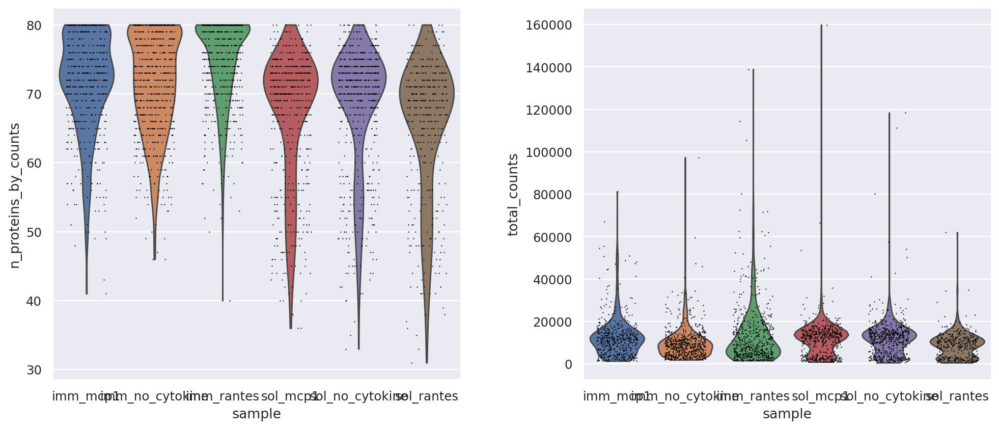

In [12]:
sc.pl.violin(
    adata,
    ["n_proteins_by_counts", "total_counts",],
    groupby='sample',
    jitter=0.3,
    multi_panel=True,
)

/tmp/ipykernel_4154820/3289861945.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  molecule_rank_df["rank"] = molecule_rank_df.groupby(["sample"])["molecules"].rank(
/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/pixelator/plot/__init__.py:133: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  edge_rank_df["rank"] = edge_rank_df.groupby([group_by])["molecules"].rank(


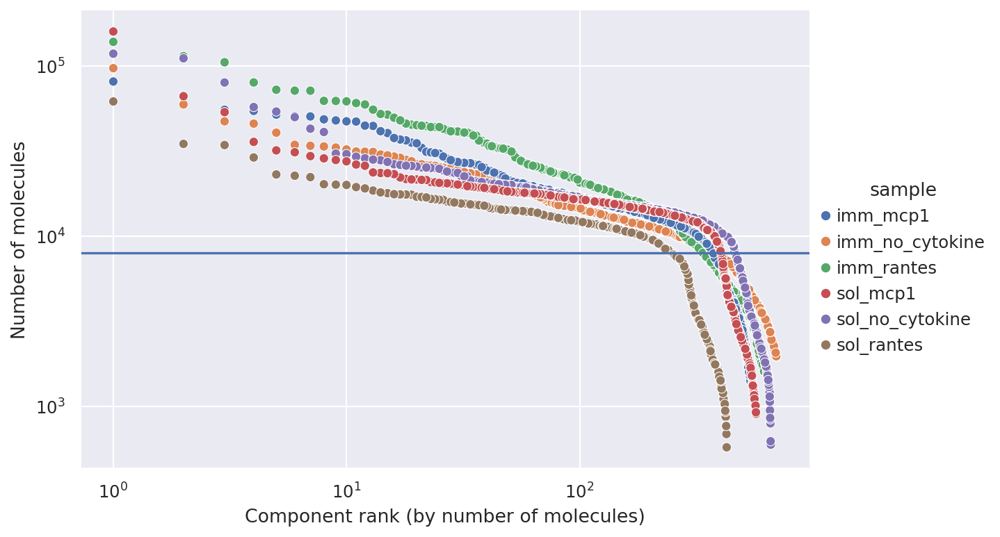

In [13]:
molecule_rank_df = adata.obs[["sample", "molecules"]].copy()
molecule_rank_df["rank"] = molecule_rank_df.groupby(["sample"])["molecules"].rank(
    ascending=False, method="first"
)
fig_intersection, ax = molecule_rank_plot(molecule_rank_df, group_by="sample")
ax.axhline(y=8000)

/tmp/ipykernel_4154820/61645433.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata.obs.groupby("sample").size().to_frame(name="size").reset_index()
/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/pixelator/plot/__init__.py:271: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_data = data.groupby(color_by).size().reset_index(name="n")


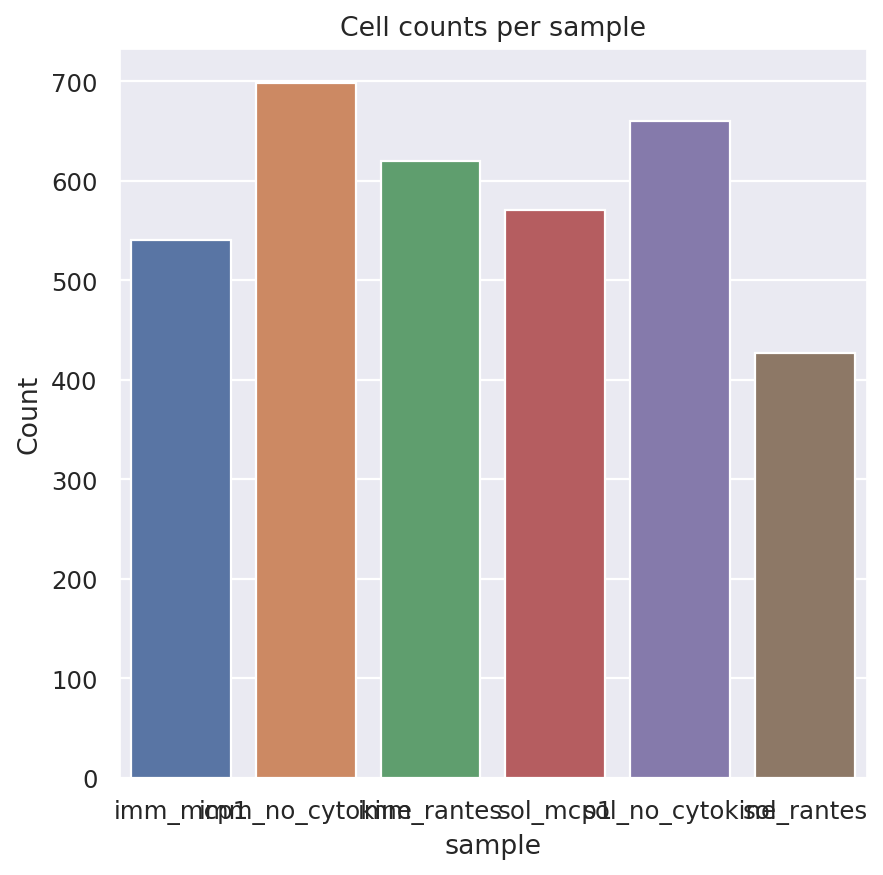

In [14]:
cells_per_sample_df = (
    adata.obs.groupby("sample").size().to_frame(name="size").reset_index()
)

fig, ax = cell_count_plot(adata.obs, color_by="sample")

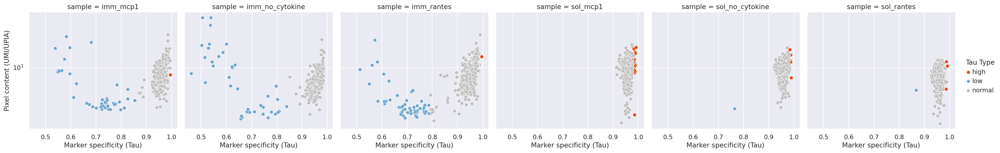

In [15]:
tau_metrics_df = adata.obs[["sample", "tau", "mean_molecules_per_a_pixel", "tau_type"]]
tau_metrics_df = tau_metrics_df.rename(columns={"mean_molecules_per_a_pixel": "umi_per_upia"})


fig, ax = scatter_umi_per_upia_vs_tau(tau_metrics_df, group_by="sample")

/tmp/ipykernel_4154820/839017279.py:8: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata.obs.groupby("sample").size().to_frame(name="size").reset_index()
/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/pixelator/plot/__init__.py:271: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_data = data.groupby(color_by).size().reset_index(name="n")


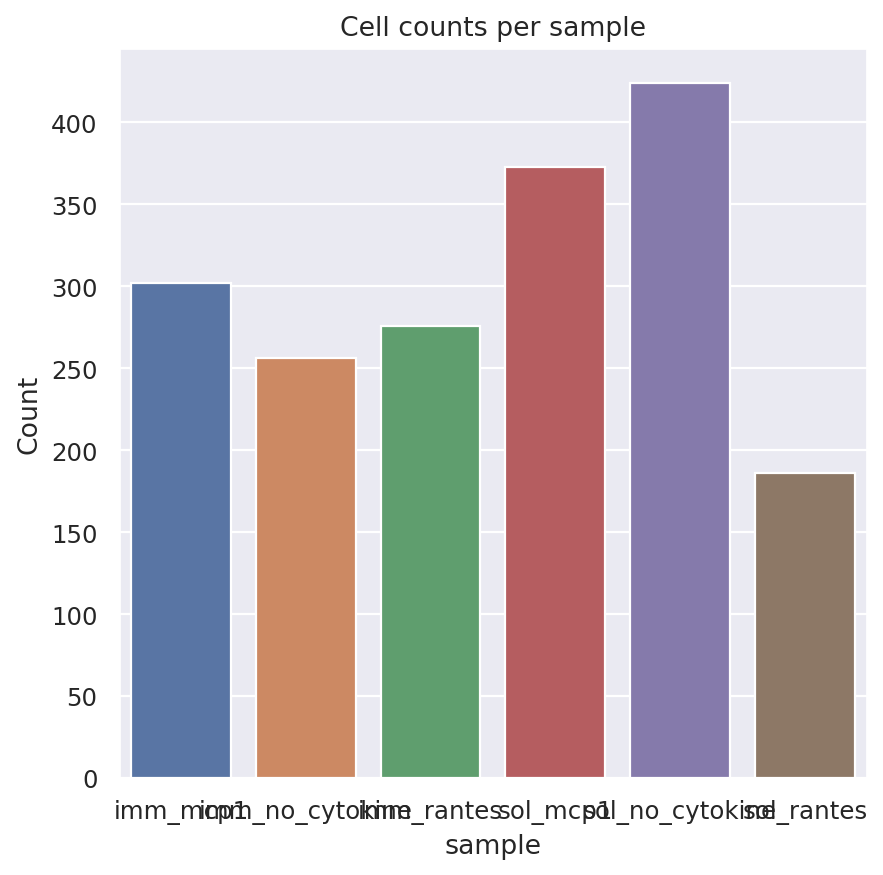

In [16]:
components = adata.obs[
    (adata.obs['tau_type'] == 'normal') & 
    (adata.obs['molecules'] > 10000)
].index
orig_adata = adata.copy()
adata = orig_adata[components, :]
cells_per_sample_df = (
    adata.obs.groupby("sample").size().to_frame(name="size").reset_index()
)

fig, ax = cell_count_plot(adata.obs, color_by="sample")

/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/scanpy/preprocessing/_normalization.py:207: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


[]

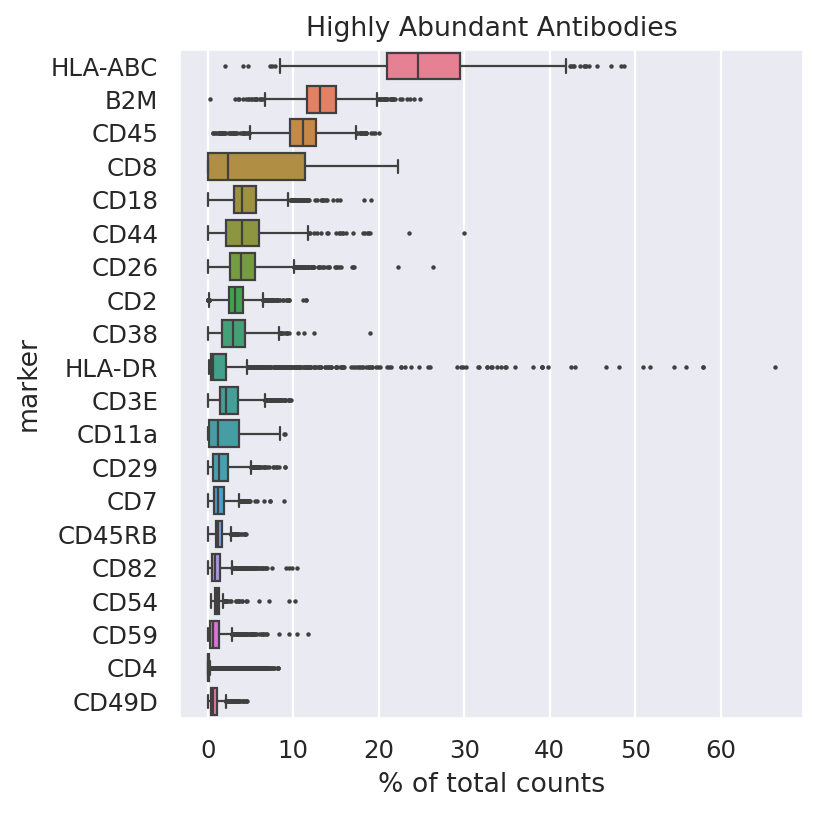

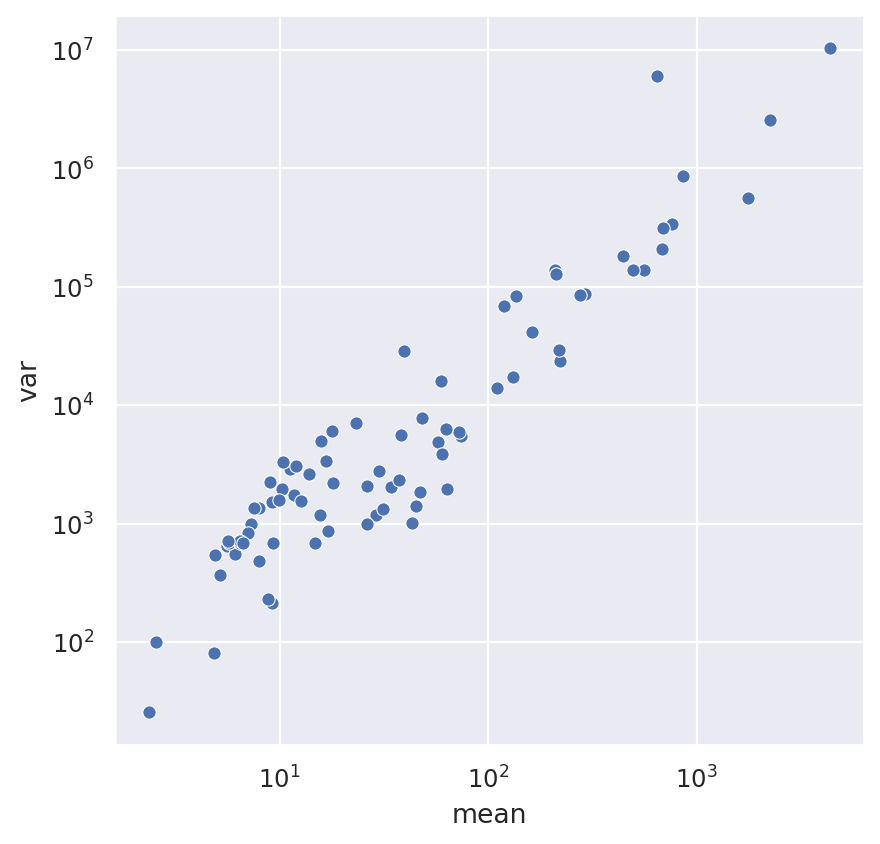

In [9]:
ax = sc.pl.highest_expr_genes(adata, n_top=20, show=False)
ax.set_title('Highly Abundant Antibodies')
stats = adata.to_df().agg(['mean', 'var',], axis=0).T
fig, ax = plt.subplots(1)
sns.scatterplot(x=stats['mean'], y=stats['var'], ax=ax)
ax.loglog()
# var_genes = sc.pp.highly_variable_genes(adata, flavor='seurat_v3', n_top_genes=20, batch_key='sample', layer='counts', inplace=False)
# sc.pl.highly_variable_genes(var_genes, show=True, log=True)

In [ ]:
# components = adata.obs[adata.obs['sample'].isin(['imm_rantes', 'sol_rantes'])].index
# adata = adata[components, :]

In [43]:
adata.obs['condition'] = ['sol' if 'sol' in sample else 'imm' for sample in adata.obs['sample']]

In [17]:
adata.layers['dsb'] = dsb_normalize(adata.to_df('counts'), isotype_controls=['mIgG1', 'mIgG2a', 'mIgG2b'])
adata.layers['clr_by_cell'] = clr_transformation(adata.to_df('counts'), axis=1)
adata.layers['clr_by_ab'] = clr_transformation(adata.to_df('counts'), axis=0)
adata.layers['log1p'] = np.log1p(adata.to_df('counts'))

/tmp/ipykernel_4154820/2096427258.py:1: ImplicitModificationWarning: Setting element `.layers['dsb']` of view, initializing view as actual.
  adata.layers['dsb'] = dsb_normalize(adata.to_df('counts'), isotype_controls=['mIgG1', 'mIgG2a', 'mIgG2b'])


<Axes: title={'center': 'Cumulative Variance Explained'}>

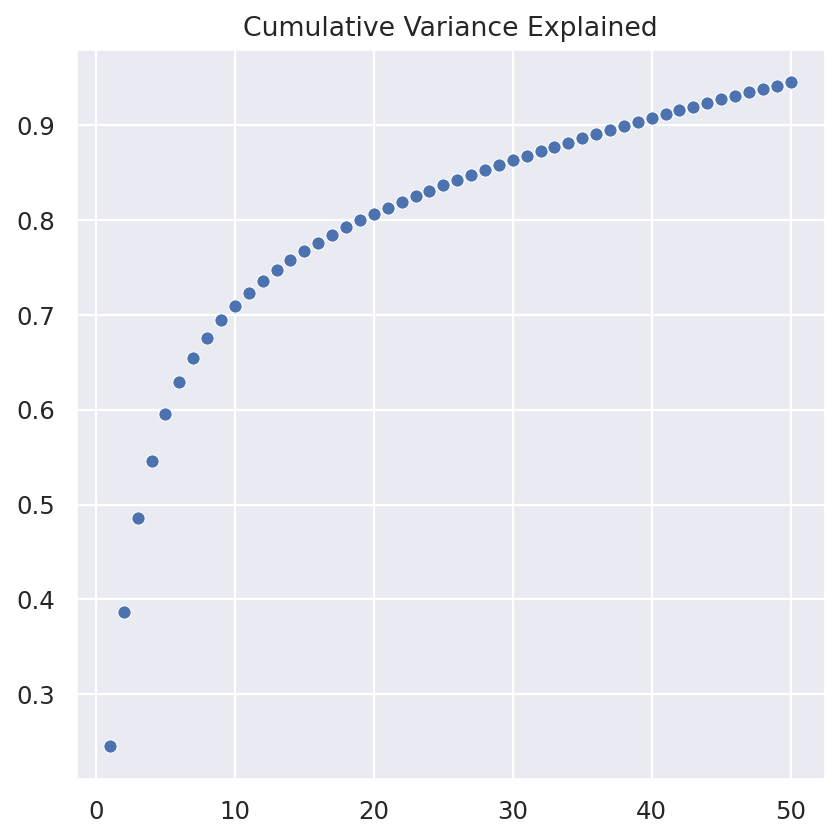

In [18]:
sc.tl.pca(adata, layer='dsb')
plot_cumulative_variance(adata)

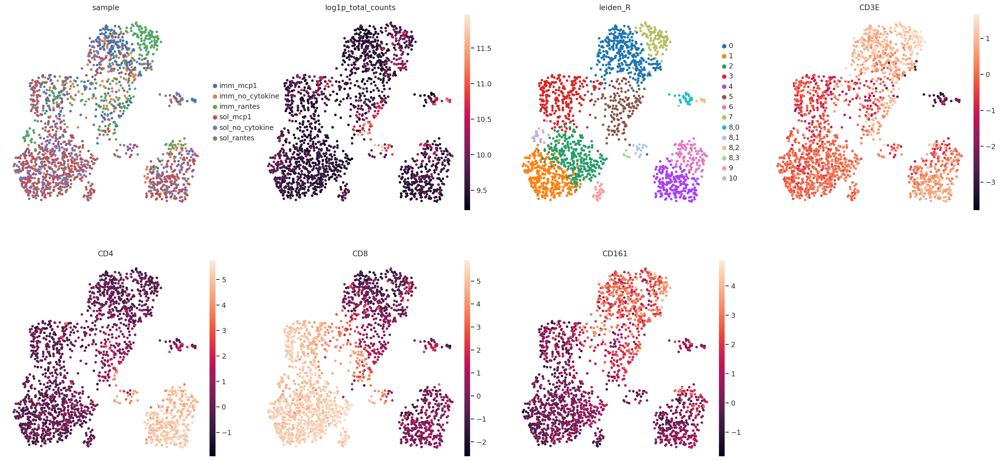

In [48]:
sc.pp.neighbors(adata,)
sc.tl.umap(adata, )
sc.tl.leiden(adata)
sc.tl.leiden(adata, restrict_to=('leiden', ['8']), resolution=0.5)
sc.pl.umap(adata, layer='dsb', color=['sample', 'log1p_total_counts', 'leiden_R', 'CD3E', 'CD4', 'CD8', 'CD161',])

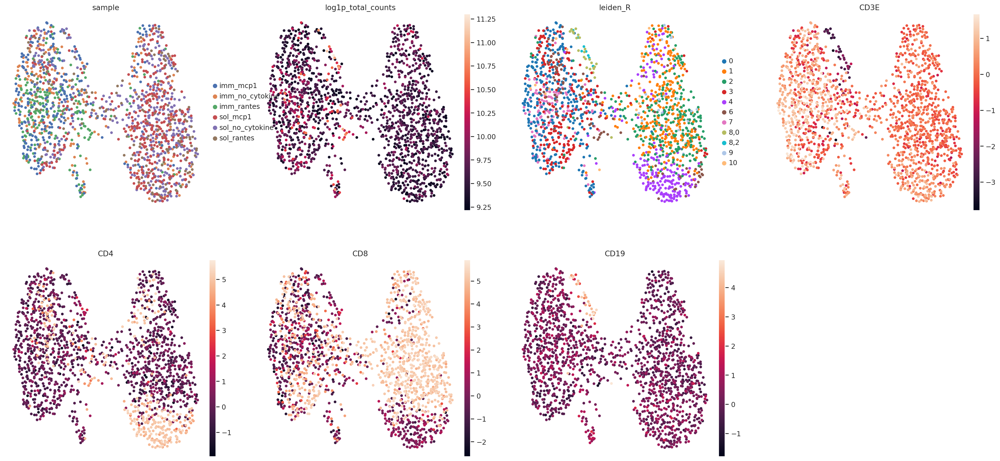

In [85]:
sc.pl.umap(adata, layer='dsb', color=['sample', 'log1p_total_counts', 'leiden_R', 'CD3E', 'CD4', 'CD8', 'CD19',])

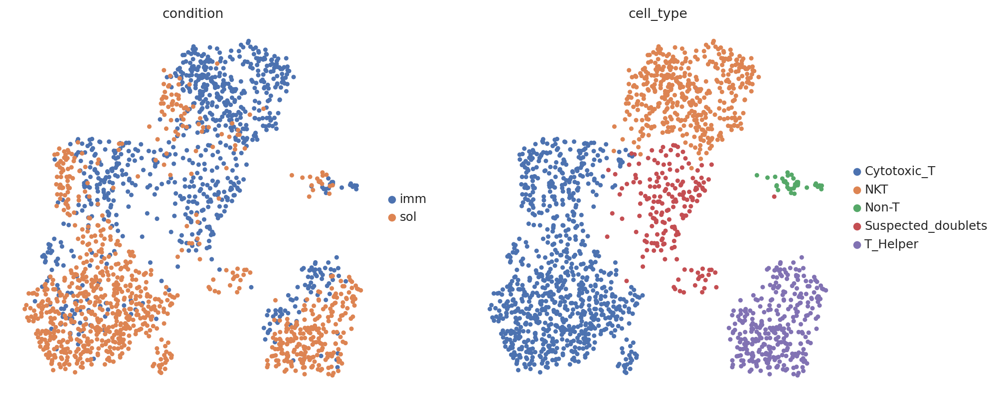

In [49]:
cell_type_dict = {'0': 'NKT', '7': 'NKT', '5': 'Suspected_doublets', '1': 'Cytotoxic_T', '2':'Cytotoxic_T', '3':'Cytotoxic_T', '9': 'Cytotoxic_T', 
                  '10': 'Cytotoxic_T', '8,1': 'Suspected_doublets', '8,3': 'Suspected_doublets', '8,0': 'Non-T', '8,2': 'Non-T', '4': 'T_Helper', '6':'T_Helper',
                  }
adata.obs['cell_type'] = adata.obs['leiden_R'].map(cell_type_dict)
sc.pl.umap(adata,  color=['condition', 'cell_type',])

In [21]:
vars = [v for v in adata.var_names if v not in ['mIgG1', 'mIgG2a', 'mIgG2b']]

polarization_i = convert_polarization_to_feature_matrix(pg_data.polarization, components=adata.obs.index, key='morans_i', vars=vars)
polarization_z = convert_polarization_to_feature_matrix(pg_data.polarization, components=adata.obs.index, key='morans_z', vars=vars)

coloc_p = convert_colocalization_to_feature_matrix(pg_data.colocalization, components=adata.obs.index, key='pearson', vars=vars)
coloc_z = convert_colocalization_to_feature_matrix(pg_data.colocalization, components=adata.obs.index, key='pearson_z', vars=vars)
adata.obsm['pol_i'] = polarization_i
adata.obsm['pol_z'] = polarization_z
adata.obsm['coloc_p'] = coloc_p
adata.obsm['coloc_z'] = coloc_z


In [3]:
from pathlib import Path

DATASET_DIR = Path('PixelGen/datasets')
# adata.write_h5ad(DATASET_DIR / 'uropod_combined_annotated_with_pol.h5ad')
adata = anndata.read_h5ad(DATASET_DIR / 'uropod_combined_annotated_with_pol.h5ad')

53
800


<Axes: xlabel='Mean', ylabel='Std'>

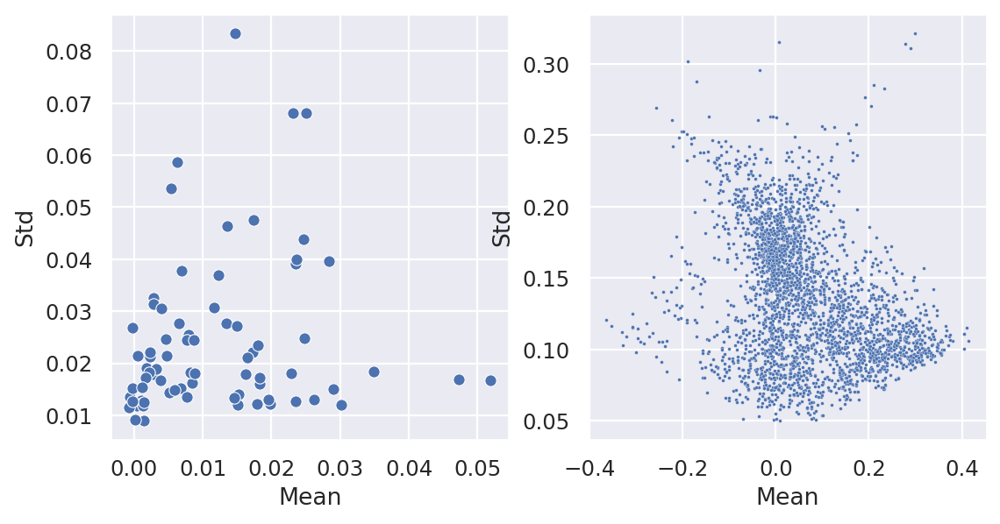

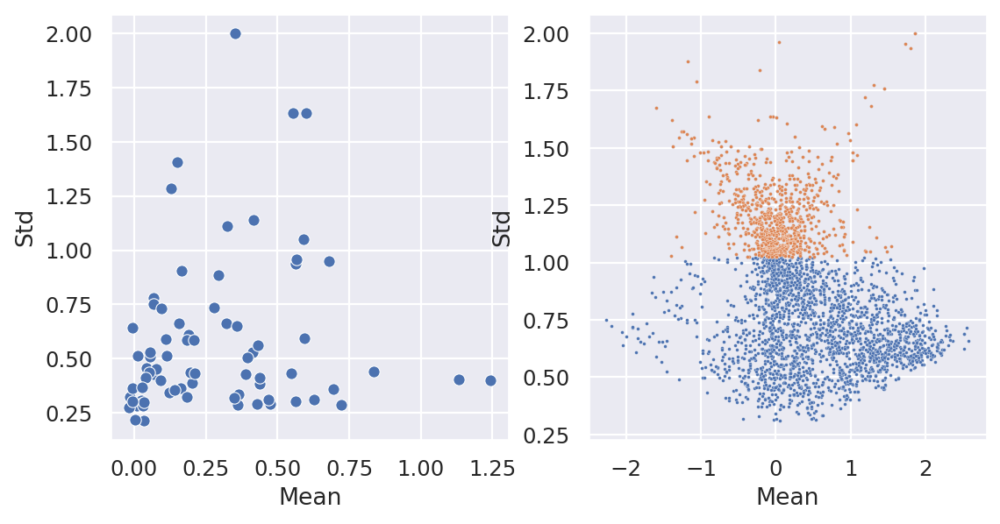

In [4]:
pol_i = adata.obsm['pol_i']
coloc_p = adata.obsm['coloc_p']


fig, ax = plt.subplots(1, 2, figsize=(8,4))
plot_mean_std(pol_i, ax=ax[0])
plot_mean_std(coloc_p, ax=ax[1], s=3)

pol_std, coloc_std = pol_i.std(axis=0), coloc_p.std(axis=0)

hv_pol = pol_std[pol_std > 0.015].index
hv_coloc = coloc_std.sort_values(ascending=False)[:800].index

print(len(hv_pol))
print(len(hv_coloc))

adata.obsm['coloc_p_hv'] = adata.obsm['coloc_p'][hv_coloc]

# Unit: in [0,1]
# Scaled: scaled so the maximum std is 2
for key in ('pol_i', 'coloc_p', 'coloc_p_hv'):
    adata.obsm[f'{key}_unit'] = (1 + adata.obsm[key]) / 2
    max_std = (adata.obsm[key].std(axis=0)).max()
    adata.obsm[f'{key}_scaled'] = adata.obsm[key] * (2 / max_std)

fig, ax = plt.subplots(1, 2, figsize=(8,4))
plot_mean_std(adata.obsm['pol_i_scaled'], ax=ax[0])
plot_mean_std(adata.obsm['coloc_p_scaled'], ax=ax[1], s=3)
plot_mean_std(adata.obsm['coloc_p_hv_scaled'], ax=ax[1], s=3)

In [5]:
added_features = {'pol_i': 'CD50_pol', 'coloc_p': '(CD162,CD50)', 'coloc_p': '(CD162,CD37)'}
for feature in added_features.values():
    if feature in adata.obs.columns:
        adata.obs.drop(columns=feature, inplace=True)
pol_adata = anndata.AnnData(
    X=adata.obsm['pol_i'],
    obs=adata.obs,
    layers={'unit': adata.obsm['pol_i_unit'],
            'scaled': adata.obsm['pol_i_scaled']
            }
)
coloc_adata = anndata.AnnData(
    X=adata.obsm['coloc_p'],
    obs=adata.obs,
    layers={'unit': adata.obsm['coloc_p_unit'],
            'scaled': adata.obsm['coloc_p_scaled']
            }
)
coloc_hv_adata = anndata.AnnData(
    X=adata.obsm['coloc_p_hv'],
    obs=adata.obs,
    layers={'unit': adata.obsm['coloc_p_hv_unit'],
            'scaled': adata.obsm['coloc_p_hv_scaled']
            }
)
# joint_adata = anndata.AnnData(
#     X=pd.concat((adata.to_df('dsb'), adata.obsm['polarization_morans_i']), axis=1),
#     obs=adata.obs
# )
for mod, feature in added_features.items():
    adata.obs[feature] = adata.obsm[mod][feature]
    if mod == 'pol_i':
        coloc_adata.obs[feature] = adata.obsm[mod][feature]
        coloc_hv_adata.obs[feature] = adata.obsm[mod][feature]
    elif mod == 'coloc_p':
        pol_adata.obs[feature] = adata.obsm[mod][feature]
    else:
        raise RuntimeError
add_one_hot_encoding_obsm(adata, obs_column='cell_type')

Text(0.5, 0.98, 'Abundance (latent=PCA)')

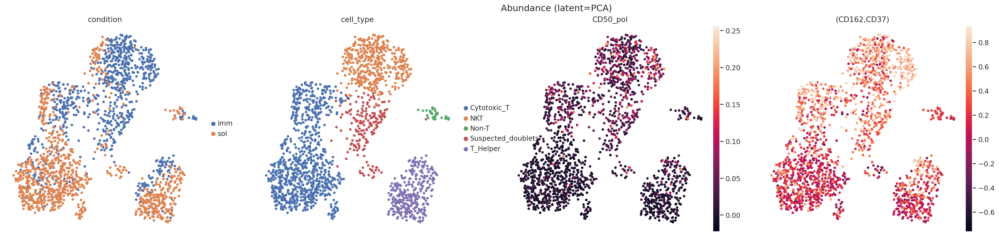

In [7]:
sc.pp.pca(adata, layer='dsb')
sc.pp.neighbors(adata, key_added='abundance_pca')
sc.tl.umap(adata, neighbors_key='abundance_pca')
sc.pl.umap(adata, layer='dsb', color=['condition', 'cell_type', 'CD50_pol', '(CD162,CD37)', ], return_fig=True).suptitle('Abundance (latent=PCA)')

### Separate abundance, polarization, and colocalization models

In [6]:
def train_model(adata, model_cls, setup_kwargs, model_kwargs, train_kwargs, modalities_latent_names):
    '''
    modalities_latent_names: list of tuples with name of modality (combined is None, main is 'X') and name of latent to put in adata
    '''
    model_cls.setup_anndata(adata, **setup_kwargs)
    model = model_cls(adata, **model_kwargs)
    model.train(**train_kwargs)
    ax = plot_losses(model)

    for modality, latent_name in modalities_latent_names:
        adata.obsm[latent_name] = model.get_latent_representation(modality=modality)
    
    return model

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/lightning/pytorch/loops/fit_loop.py:310: The number of training batches (1) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training:   0%|          | 0/10000 [00:00<?, ?it/s]

Monitored metric elbo_validation did not improve in the last 50 records. Best score: 60.078. Signaling Trainer to stop.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/lightning/pytorch/loops/fit_loop.py:310: The number of training batches (1) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training:   0%|          | 0/10000 [00:00<?, ?it/s]

Monitored metric elbo_validation did not improve in the last 50 records. Best score: -222.398. Signaling Trainer to stop.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/lightning/pytorch/loops/fit_loop.py:310: The number of training batches (1) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training:   0%|          | 0/10000 [00:00<?, ?it/s]

Monitored metric elbo_validation did not improve in the last 50 records. Best score: -713.488. Signaling Trainer to stop.


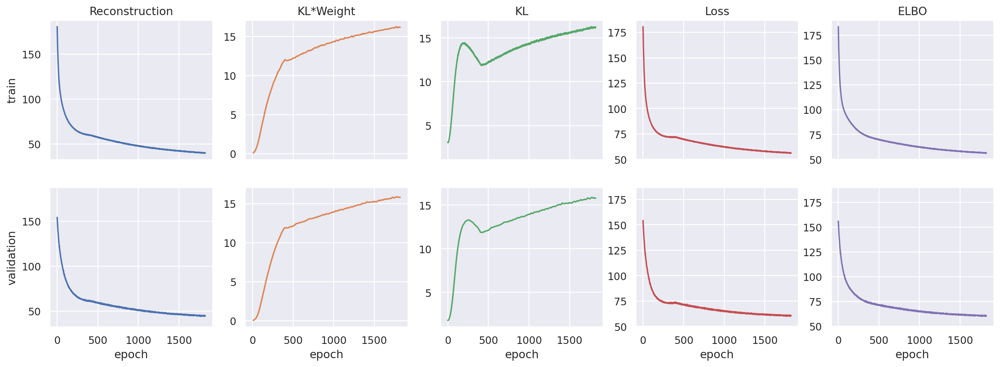

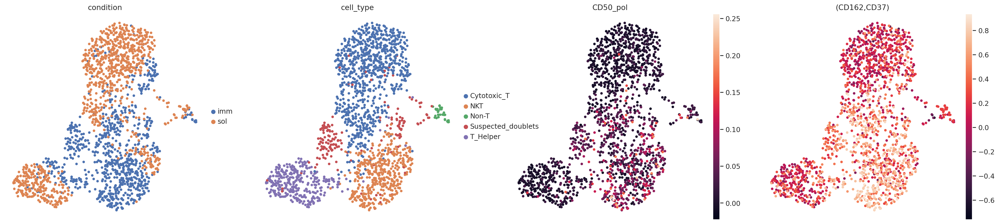

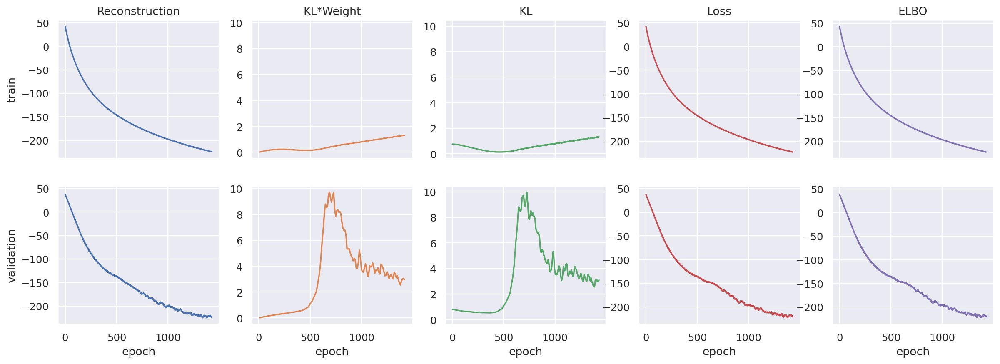

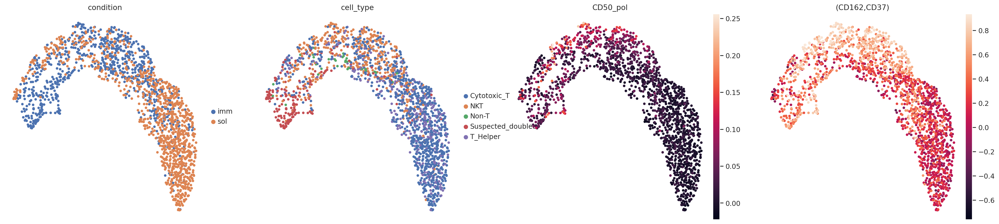

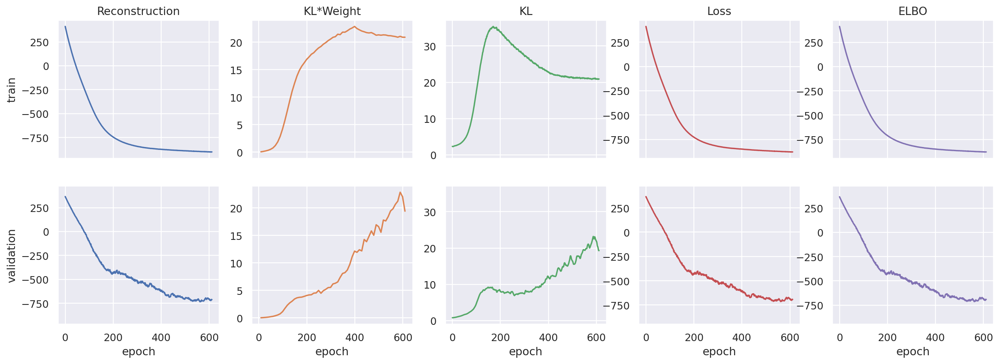

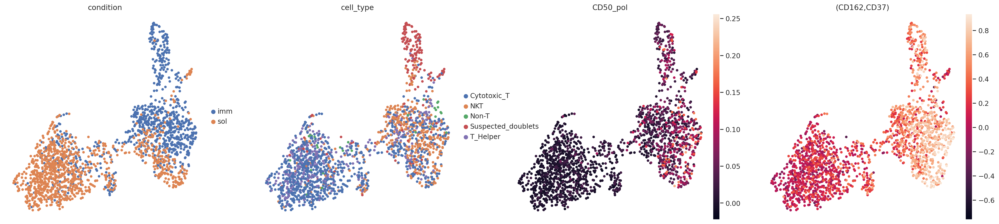

In [11]:
model_cls = MultiModalSCVI
train_kwargs = dict(train_size=0.8, check_val_every_n_epoch=1, early_stopping=True, early_stopping_patience=50, batch_size=2000,
                    max_epochs=10000, enable_checkpointing=True, plan_kwargs=dict(lr=3e-4, optimizer='Adam', n_epochs_kl_warmup=400))
model_kwargs = dict(n_latent=20, n_hidden=128, n_layers=1, dropout_rate=0.1, )
marginal_models = []
for mod_adata, layer, latent_name in zip((adata, pol_adata, coloc_hv_adata), ('dsb', 'unit', 'unit'), ('abundance_model', 'pol_i_unit_model', 'coloc_p_hv_unit_model')):
    model_kwargs['distrs'] = [{'dsb': 'normal', 'unit': 'beta'}[layer]]
    setup_kwargs = dict(layer=layer, batch_key=None)
    model = train_model(mod_adata, model_cls=model_cls, setup_kwargs=setup_kwargs, model_kwargs=model_kwargs, train_kwargs=train_kwargs, 
                        modalities_latent_names=[('X', latent_name)])
    marginal_models.append(model)
    fig = pca_neighbors_umap(mod_adata, latent_name, umap_pl_kwargs=dict(color=['condition', 'cell_type', 'CD50_pol', '(CD162,CD37)']))
    fig.show()
abundance_model, pol_i_model, coloc_p_hv_model = marginal_models

In [67]:
autocorr = distr_autocorrelation_in_latent(coloc_hv_adata, latent_neighbors_connectivities_key_lst=['coloc_p_hv_unit_model_connectivities'], 
                                           names=['Coloc Model'], distr_key='unit')
print(autocorr.sort_values(by='morans', ascending=False)[:20].index)

Index(['(CD162,CD50)', '(CD37,CD50)', '(CD162,CD37)', '(ACTB,B2M)',
       '(ACTB,HLA-ABC)', '(CD279,CD40)', '(ACTB,CD40)', '(CD268,CD40)',
       '(ACTB,CD127)', '(CD268,CD279)', '(B2M,CD279)', '(CD127,CD40)',
       '(ACTB,CD25)', '(CD279,HLA-ABC)', '(ACTB,CD278)', '(ACTB,CD279)',
       '(CD268,CD278)', '(CD278,CD279)', '(CD279,CD53)', '(CD25,CD279)'],
      dtype='object')


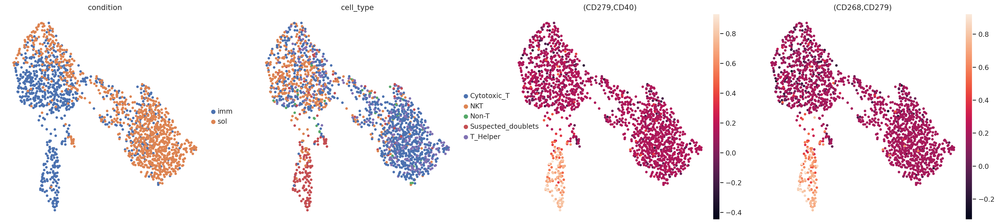

In [70]:
fig = pca_neighbors_umap(coloc_hv_adata, 'coloc_p_hv_unit_model', umap_pl_kwargs=dict(color=['condition', 'cell_type', '(CD279,CD40)', '(CD268,CD279)']))

## Multi Modal Model

In [7]:
# orig_adata = adata.copy()
adata = adata[adata.obs[adata.obs['cell_type'] != 'Suspected_doublets'].index,:].copy()
print(adata.obs['cell_type'].unique())

['T_Helper', 'Cytotoxic_T', 'NKT', 'Non-T']
Categories (4, object): ['Cytotoxic_T', 'NKT', 'Non-T', 'T_Helper']


INFO     Using column names from columns of adata.obsm['pol_i_unit']                                               
INFO     Using column names from columns of adata.obsm['coloc_p_hv_unit']                                          


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/lightning/pytorch/loops/fit_loop.py:310: The number of training batches (1) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training:   0%|          | 0/10000 [00:00<?, ?it/s]

Monitored metric elbo_validation did not improve in the last 50 records. Best score: -875.949. Signaling Trainer to stop.


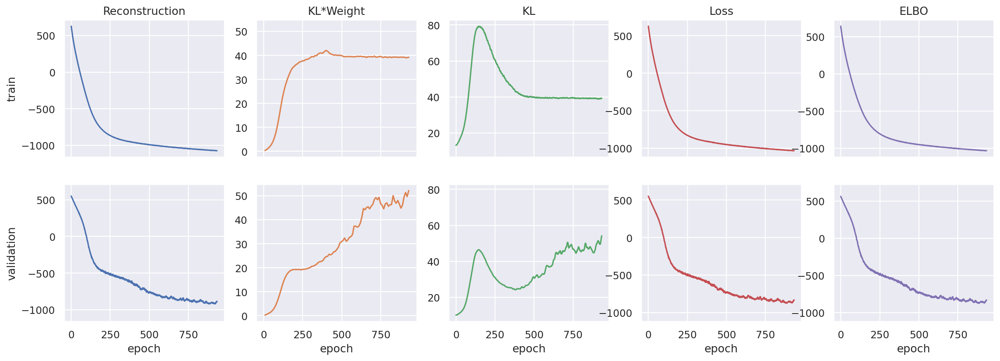

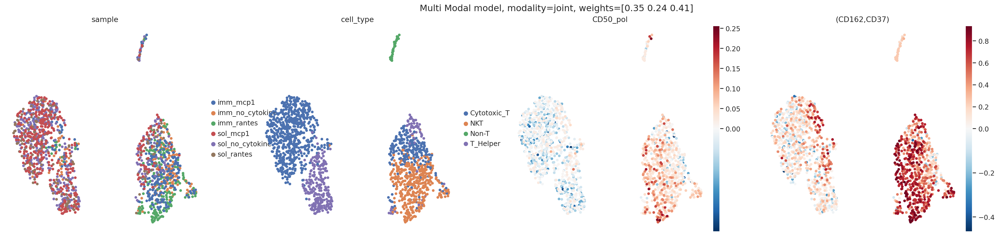

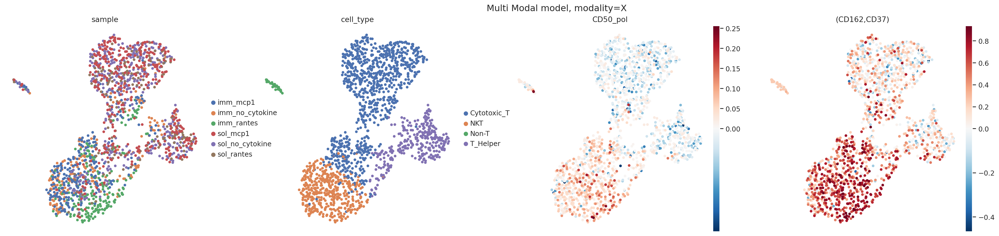

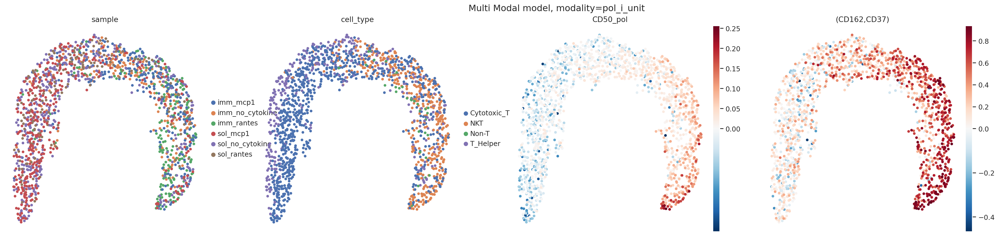

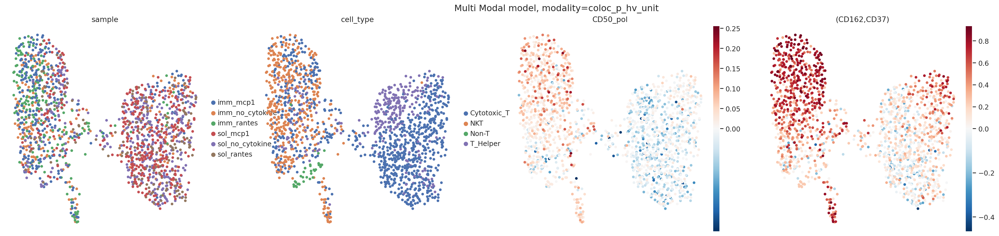

In [8]:
model_cls = MultiModalSCVI
setup_kwargs = dict(layer='dsb', batch_key=None, obsm_extra_modality_keys=['pol_i_unit', 'coloc_p_hv_unit'], n_modalities=3)
model_kwargs = dict(n_latent=20, n_hidden=128, n_layers=1, dropout_rate=0.1, distrs=['normal', 'beta', 'beta'], weights=None, agg_method='learned_global_avg',
                    unimodal_kl=True, joint_kl=True, 
                    )

train_kwargs = dict(train_size=0.8, check_val_every_n_epoch=1, early_stopping=True, early_stopping_patience=50, batch_size=2000,
                    max_epochs=10000, enable_checkpointing=True, plan_kwargs=dict(lr=3e-4, optimizer='Adam', n_epochs_kl_warmup=400))

modalities_latent_names = [('joint', 'multi_model_joint'), ('X', 'multi_model_abundance'), ('pol_i_unit', 'multi_model_pol'), ('coloc_p_hv_unit', 'multi_model_coloc')]

multi_model = train_model(adata, model_cls=model_cls, setup_kwargs=setup_kwargs, model_kwargs=model_kwargs, train_kwargs=train_kwargs, modalities_latent_names=modalities_latent_names)

for modality, latent_name in modalities_latent_names:
    fig = pca_neighbors_umap(adata, latent_name, umap_pl_kwargs=dict(color=['sample', 'cell_type', 'CD50_pol', '(CD162,CD37)'], vcenter=0, cmap='RdBu_r'), )
    weights = multi_model.module.weights
    weights_str = np.array2string(weights, precision=2) if weights is not None else 'Per Point'
    if modality == 'joint':
        fig.suptitle(f'Multi Modal model, modality={modality}, weights={weights_str}')
    else:
        fig.suptitle(f'Multi Modal model, modality={modality}')
    fig.show()

In [6]:
rantes_components = [c for c in adata.obs.index if 'rantes' in c]
rantes_adata = adata[rantes_components, :]

/home/labs/nyosef/eitangr/pixelgen/PixelGen/pxl_utils.py:684: ImplicitModificationWarning: Setting element `.obsm['multi_model_joint_pca']` of view, initializing view as actual.
  adata.obsm[f'{key_added}_pca'] = pca_data.obsm['X_pca']


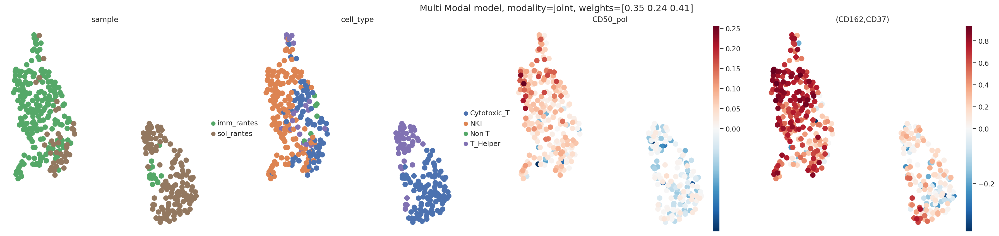

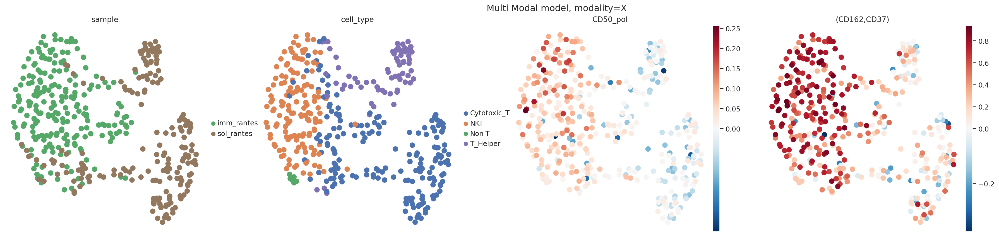

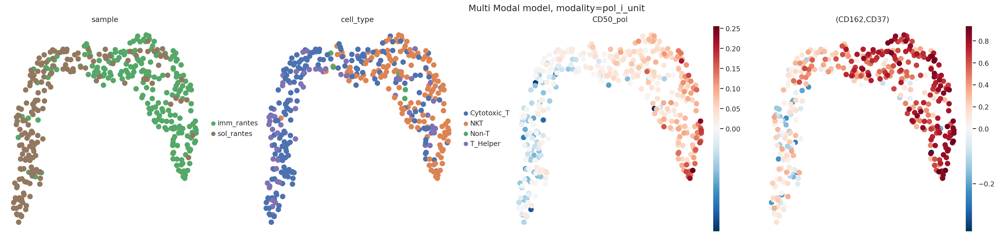

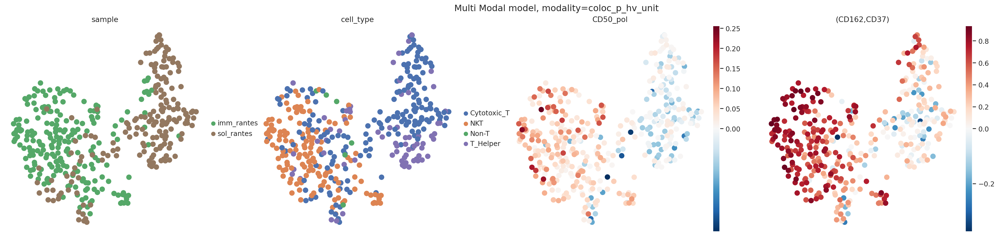

In [9]:
for modality, latent_name in modalities_latent_names:
    fig = pca_neighbors_umap(rantes_adata, latent_name, umap_pl_kwargs=dict(color=['sample', 'cell_type', 'CD50_pol', '(CD162,CD37)'], vcenter=0, cmap='RdBu_r'), )
    weights = multi_model.module.weights
    weights_str = np.array2string(weights, precision=2) if weights is not None else 'Per Point'
    if modality == 'joint':
        fig.suptitle(f'Multi Modal model, modality={modality}, weights={weights_str}')
    else:
        fig.suptitle(f'Multi Modal model, modality={modality}')
    fig.show()

In [90]:
adata.obsm['coloc_p']['(CD162,CD37)'].sort_values(ascending=False)

component
RCVCMP0001352_imm_rantes         0.938389
RCVCMP0001141_imm_rantes         0.934702
RCVCMP0005012_imm_rantes         0.932301
RCVCMP0000741_imm_no_cytokine    0.926398
RCVCMP0001292_imm_rantes         0.924877
                                   ...   
RCVCMP0000150_sol_mcp1          -0.395741
RCVCMP0000415_sol_mcp1          -0.447157
RCVCMP0000299_sol_no_cytokine   -0.466850
RCVCMP0000109_sol_no_cytokine   -0.497558
RCVCMP0000039_sol_rantes        -0.761012
Name: (CD162,CD37), Length: 1817, dtype: float64

In [28]:
pg_data.edgelist.head(10)

,upia,upib,umi,marker,sequence,count,unique_molecules_count,component,sample
0,TCGCTCTATCTCATTGTATATTGTG,AGGCTGTACGGTTGGGCCAATCCCG,CGGTAAACAC,CD152,AACGGCTA,36,1,RCVCMP0000000_imm_no_cytokine,imm_no_cytokine
1,CATTGGATTCCGTATTGAAAAAGAG,GCTTGCTTCTACTAAGGAATTATTA,TAACAGAGCA,CD152,AACGGCTA,36,1,RCVCMP0000001_imm_no_cytokine,imm_no_cytokine
2,CCGCGGCAAGGGGTTTTAGTCGGAG,TTGACTTTACTTTGTTGCTGAGACA,AAAGCAAGGG,CD152,AACGGCTA,37,2,RCVCMP0000004_imm_no_cytokine,imm_no_cytokine
3,AGTACTAAATTACTTTTGTGCGAGG,TCTTCTCAGTTATTTAATATTCATA,CACCAGGCCC,CD152,AACGGCTA,34,1,RCVCMP0000006_imm_no_cytokine,imm_no_cytokine
4,TTATGGTCCAAGGGCTCGATCGGCG,GATGTTTGGAAGCGTGGTTGACTAG,GAATGTGGCC,CD152,AACGGCTA,33,1,RCVCMP0000007_imm_no_cytokine,imm_no_cytokine
5,TGAGATGTTAGAAACGTGACACGGG,AATGCCCTTTGAGGTTACACTTACG,TGACTGAGGA,CD152,AACGGCTA,32,1,RCVCMP0000008_imm_no_cytokine,imm_no_cytokine
6,TAGTGCTAACCTTACGTATAGCGAT,TCAGTTCAACGTTTTACATTACGAA,CCAACCATCA,CD152,AACGGCTA,32,1,RCVCMP0000013_imm_no_cytokine,imm_no_cytokine
7,TATTTCGTGCTTCATGAGGCGAGCT,GAATAAAGAGCTTAGGAGAGGCCAT,AAAACAACGT,CD152,AACGGCTA,31,1,RCVCMP0000014_imm_no_cytokine,imm_no_cytokine
8,ATGATACGTGAAAAGTAGACGATAC,GTGCGTTAAATTTCTTCATCAGCTG,CATAGCGACA,CD152,AACGGCTA,31,1,RCVCMP0000016_imm_no_cytokine,imm_no_cytokine
9,GCATATCTTCTTGATTTCAGAGGTT,AGCACTGATTTTTGTCAATCAAAGA,AAGATAACGT,CD152,AACGGCTA,31,1,RCVCMP0000018_imm_no_cytokine,imm_no_cytokine


In [36]:
def plot_corr_data(counts, norm_counts, corr, norm_corr, m1, m2):
    fig, ax = plt.subplots(1,2,figsize=(12,7))
    df_agg = counts.groupby([m1,m2]).size().reset_index(name='count')
    df_agg['log_count'] = np.log(df_agg['count'])

    df_norm_agg = norm_counts.groupby([m1,m2]).size().reset_index(name='count')
    df_norm_agg['log_count'] = np.log(df_agg['count'])
    # df_agg = df_agg[df_agg[m1] + df_agg[m2] > 0]


    # Create a scatter plot where 'count' determines the marker size.
    sns.scatterplot(data=df_agg, x=m1, y=m2, size='log_count', sizes=(20, 200), legend=True, ax=ax[0])
    # sns.scatterplot(gld_a_counts,x='CD162',y='CD50', ax=ax[0])
    sns.scatterplot(data=df_norm_agg,x=m1,y=m2, size='log_count', sizes=(20, 200), legend=True, ax=ax[1])
    ax[0].set_title(f'{corr.loc[m1,m2]:.3f}')
    ax[1].set_title(f'{norm_corr.loc[m1,m2]:.3f}')

    for i, df in enumerate((counts, norm_counts)):
        ax[i].axhline(y=df[m2].mean(), linestyle='--')
        ax[i].axvline(x=df[m1].mean(), linestyle='--')

In [ ]:
!cd

In [5]:
from scipy.sparse import coo_array
from graph_coarsening.graph_coarsening.coarsening_utils import coarsen

16097


<Axes: xlabel='Count', ylabel='Count'>

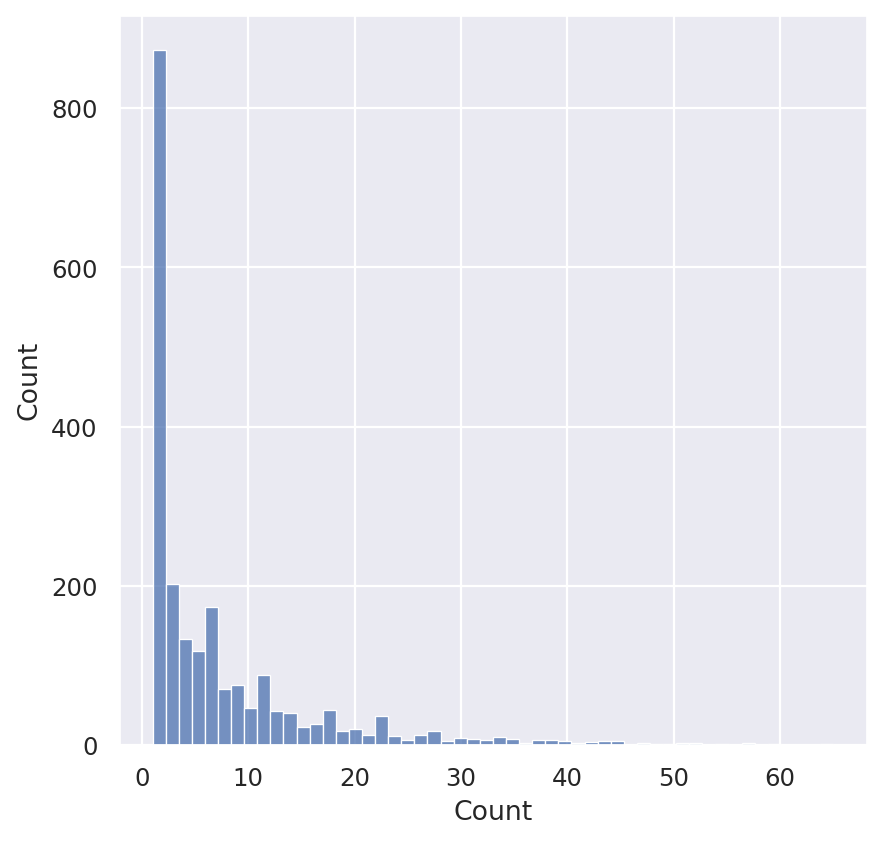

In [98]:
pixel_counts = results['pixel_counts']
a_pixel_counts = pixel_counts[pixel_counts['type'] == 'a']
pixel_size = a_pixel_counts.groupby('upi_int')['Count'].sum()
print(pixel_size.sum())
sns.histplot(pixel_size)

In [101]:
from pygsp.graphs import Graph


In [9]:
nbhd_counts

,nbhd_center_upi_int,marker,Count,component
0,0,B2M,4,RCVCMP0000001_imm_no_cytokine
1,0,CD152,1,RCVCMP0000001_imm_no_cytokine
2,0,CD2,1,RCVCMP0000001_imm_no_cytokine
3,0,CD26,9,RCVCMP0000001_imm_no_cytokine
4,0,CD268,1,RCVCMP0000001_imm_no_cytokine
...,...,...,...,...
56312,2186,CD59,1,RCVCMP0000001_imm_no_cytokine
56313,2186,CD7,1,RCVCMP0000001_imm_no_cytokine
56314,2186,CD8,1,RCVCMP0000001_imm_no_cytokine
56315,2186,HLA-ABC,32,RCVCMP0000001_imm_no_cytokine


In [42]:
pixel_counts

,upi_int,marker,Count,type,component
0,0,B2M,1,a,RCVCMP0000001_imm_no_cytokine
1,0,CD152,1,a,RCVCMP0000001_imm_no_cytokine
2,0,CD268,1,a,RCVCMP0000001_imm_no_cytokine
3,0,CD314,2,a,RCVCMP0000001_imm_no_cytokine
4,0,CD3E,1,a,RCVCMP0000001_imm_no_cytokine
...,...,...,...,...,...
9375,2182,HLA-ABC,1,a,RCVCMP0000001_imm_no_cytokine
9376,2183,HLA-ABC,1,a,RCVCMP0000001_imm_no_cytokine
9377,2184,HLA-ABC,1,a,RCVCMP0000001_imm_no_cytokine
9378,2185,HLA-ABC,1,a,RCVCMP0000001_imm_no_cytokine


In [46]:
np.mean(pixel_size)

12.956028368794327

In [52]:
sum(g.dw < 30) / len(g.dw)

0.5035460992907801

[19/03/25 11:36:14]: Starting conversion...


100%|██████████| 1/1 [00:00<00:00,  4.38it/s]


0.18261440770746662


122    1
269    4
248    4
243    4
233    4
249    5
179    5
153    6
82     6
84     7
247    7
201    7
67     7
159    8
253    8
145    8
255    8
256    8
185    9
232    9
dtype: int64

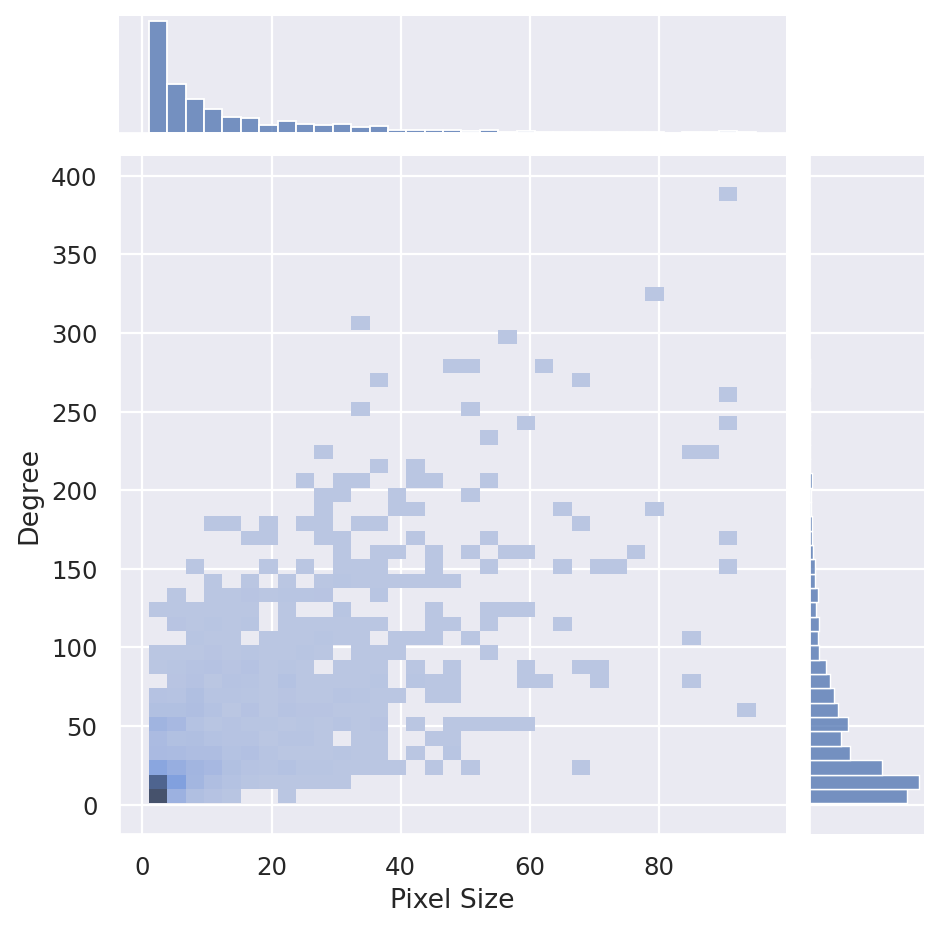

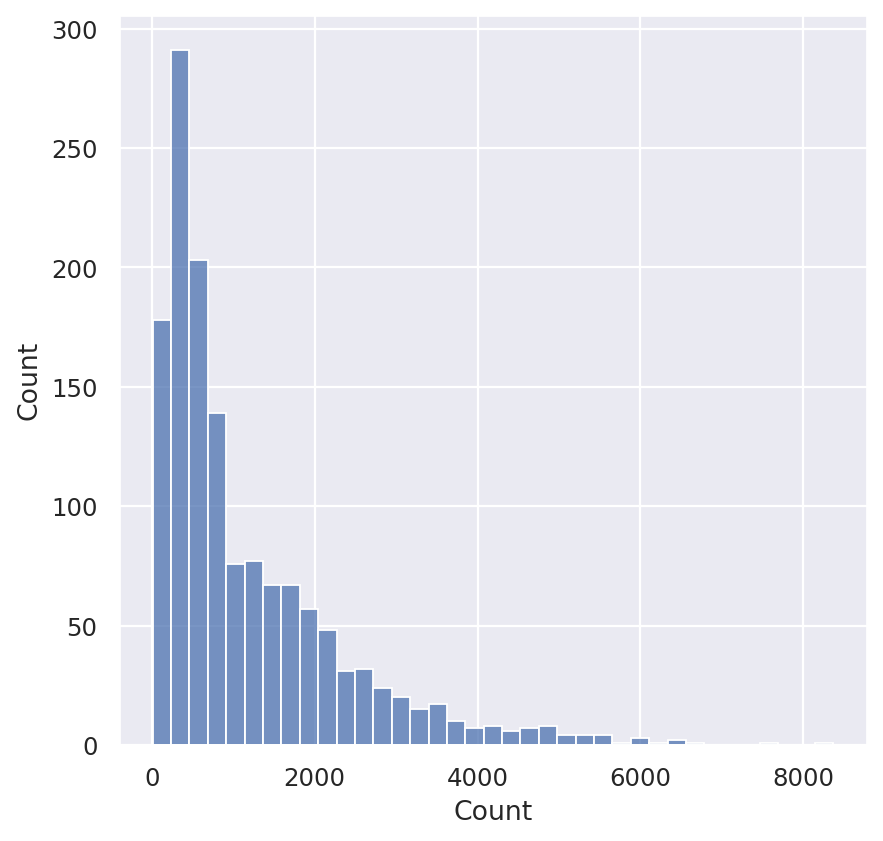

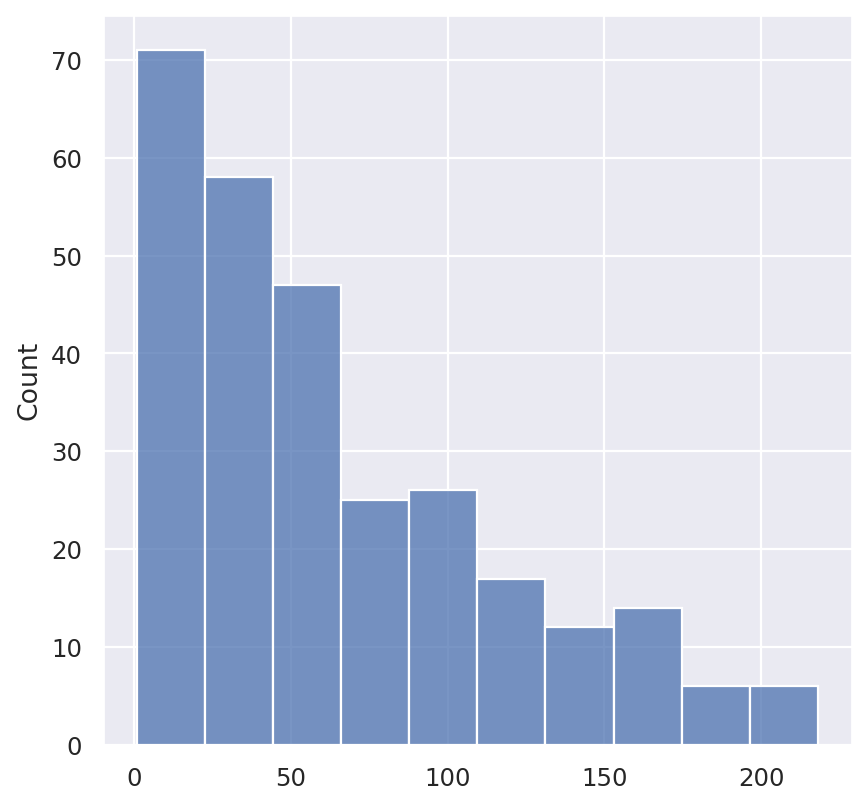

In [34]:
component = 'RCVCMP0001352_imm_rantes'
results = get_pixel_nbhd_counts(pg_data.edgelist, adata, pixel_type='a', nbhd_radius=2, components=[component], compute_pixel_graph=True)
pixel_counts = results['pixel_counts']
nbhd_counts = results['nbhd_counts']
nbhd_size = nbhd_counts.groupby('nbhd_center_upi_int')['Count'].sum()
a_pixel_counts = pixel_counts[pixel_counts['type'] == 'a']
pixel_size = a_pixel_counts.groupby('upi_int')['Count'].sum().rename('Pixel Size')
# sns.histplot(pixel_size)

g = results['graphs'][0]
# sns.histplot(g.dw)
sns.jointplot(x=pixel_size, y=pd.Series(g.dw, name='Degree'), kind='hist')
fig, ax = plt.subplots()
sns.histplot(nbhd_size, ax=ax)

weights_coo = g.W.tocoo()
coords = weights_coo.row, weights_coo.col
new_weights =([200 -(pixel_size[i] + pixel_size[j]) for i,j in zip(*coords)])
new_W = coo_array((new_weights, coords), shape=weights_coo.shape)
# sns.histplot(new_weights)
new_g = Graph(new_W)
C, coarse_g, _, _ = coarsen(new_g, K=10, r=0.8, method='heavy_edge')
# _, _, weights = g.get_edge_list()
# weight_coo = g.W
# g.set_coordinates(kind='random2D')

# C.data

new_N = C.shape[0]
new_sizes = (C.astype(bool).toarray() * np.array(pixel_size).reshape((1, -1)).repeat(new_N, axis=0)).sum(axis=1)
fig, ax = plt.subplots()
sns.histplot(new_sizes, ax=ax)
print(new_sizes[new_sizes < 50].sum() / new_sizes.sum())
pd.Series(new_sizes).sort_values().head(20)

In [57]:
import statsmodels.api as sm
from statsmodels.stats.weightstats import DescrStatsW

In [105]:
abundant_markers = [v for v in adata.var_names if adata.to_df('counts').loc[component, v] > 30]
abundant_markers

['B2M',
 'CD102',
 'CD16',
 'CD162',
 'CD18',
 'CD2',
 'CD26',
 'CD278',
 'CD29',
 'CD37',
 'CD38',
 'CD3E',
 'CD44',
 'CD45',
 'CD45RB',
 'CD47',
 'CD48',
 'CD49D',
 'CD5',
 'CD50',
 'CD52',
 'CD54',
 'CD59',
 'CD69',
 'CD7',
 'CD82',
 'CD86',
 'HLA-ABC',
 'HLA-DR']

,marker,marker_2,value,abs
5688,CD72,mIgG2a,0.702110,0.702110
4938,mIgG2a,CD72,0.702110,0.702110
1223,CD150,CD19,0.669857,0.669857
548,CD19,CD150,0.669857,0.669857
1027,CD37,CD162,0.667191,0.667191
2977,CD162,CD37,0.667191,0.667191
3599,CD27,CD45RA,0.632786,0.632786
2099,CD45RA,CD27,0.632786,0.632786
4492,CD152,CD62P,0.569626,0.569626
667,CD62P,CD152,0.569626,0.569626


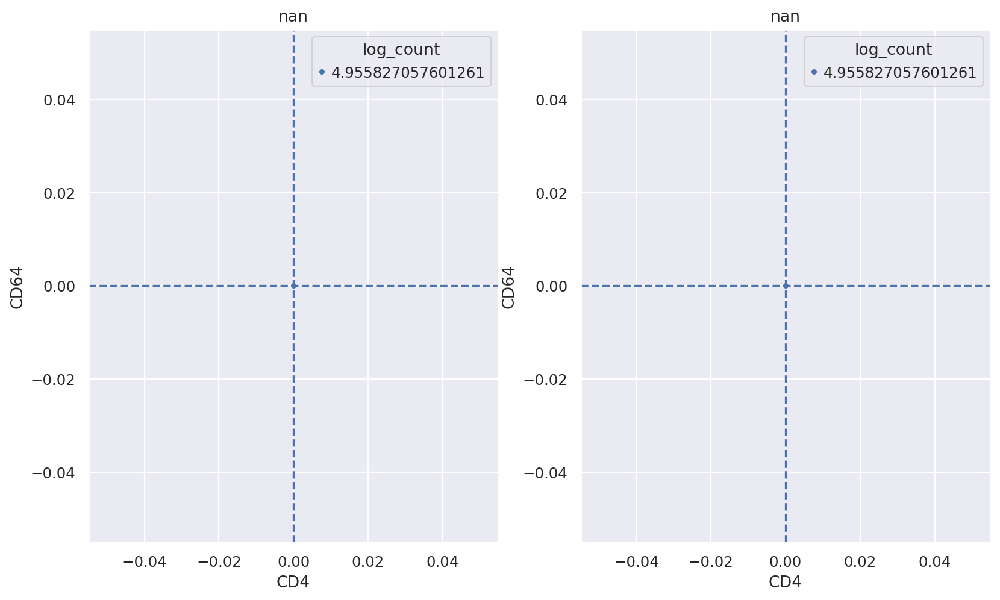

In [40]:



coarse_to_fine = pd.DataFrame(np.argwhere(C), columns=['coarse', 'fine'])
coarse_to_fine = coarse_to_fine.join(pixel_counts.set_index('upi_int')[['marker', 'Count']], on='fine')
coarse_counts = coarse_to_fine.groupby(['coarse', 'marker'], observed=True, as_index=False)['Count'].sum()
coarse_counts_pivot = pd.pivot_table(coarse_counts, index='coarse', columns='marker', values='Count', observed=True, fill_value=0).astype(int)
coarse_sizes = coarse_counts_pivot.sum(axis=1)

filtered_coarse = coarse_counts_pivot.loc[coarse_sizes > 50]
filtered_coarse_sizes = filtered_coarse.sum(axis=1)
filtered_coarse_norm = filtered_coarse.div(filtered_coarse_sizes, axis=0)

# abundant_markers = [v for v in adata.var_names if adata.to_df('counts').loc[component, v] > 30]
abundant_markers = [v for v in filtered_coarse.columns]

filtered_abundant = filtered_coarse[abundant_markers]
filtered_abundant_norm = filtered_coarse_norm[abundant_markers]



filtered_coarse_corr = filtered_abundant.corr('pearson')
filtered_coarse_norm_corr = filtered_abundant_norm.corr('pearson')

plot_corr_data(counts=filtered_abundant, norm_counts=filtered_abundant_norm, corr=filtered_coarse_corr, norm_corr=filtered_coarse_norm_corr,
               m1='CD4', m2='CD64')

long_corr = filtered_coarse_norm_corr.melt(ignore_index=False).rename(index={'marker':'marker_1'}, columns={'marker': 'marker_2'}).reset_index()
long_corr = long_corr[long_corr['value'] != 1]
long_corr['abs'] = np.abs(long_corr['value'])
long_corr.sort_values(by='abs', ascending=False).head(20)
# sns.histplot(filtered_coarse_norm['CD150'])

In [101]:
adata.obsm['coloc_z']

,"(ACTB,B2M)","(ACTB,CD102)","(ACTB,CD11a)","(ACTB,CD11b)","(ACTB,CD11c)","(ACTB,CD127)","(ACTB,CD137)","(ACTB,CD14)","(ACTB,CD150)","(ACTB,CD152)",...,"(CD86,CD9)","(CD86,HLA-ABC)","(CD86,HLA-DR)","(CD86,TCRVb5)","(CD9,HLA-ABC)","(CD9,HLA-DR)","(CD9,TCRVb5)","(HLA-ABC,HLA-DR)","(HLA-ABC,TCRVb5)","(HLA-DR,TCRVb5)"
component,,,,,,,,,,,,,,,,,,,,,
RCVCMP0000001_imm_no_cytokine,-27.198395,-3.466488,6.680619,23.099916,20.834111,21.356958,16.382137,29.487447,15.073092,4.137298,...,11.837774,-6.512639,2.934025,4.273240,-26.696321,2.018809,9.044784,-0.499030,-4.884644,4.904005
RCVCMP0000004_imm_no_cytokine,-4.233447,0.309909,2.550669,9.069459,6.500379,5.239832,10.617068,12.249622,7.331684,3.437178,...,-3.398381,-3.354460,-5.315561,13.365655,-0.823847,0.032335,-1.125420,0.484218,-7.353198,-5.824627
RCVCMP0000006_imm_no_cytokine,-1.035286,0.526916,-2.559796,1.187077,6.500379,4.253491,10.617068,12.249622,7.331684,-2.196926,...,5.773971,-6.706060,5.478731,-1.806969,-3.905758,4.670861,9.023255,-2.052894,-1.341757,3.130884
RCVCMP0000008_imm_no_cytokine,-19.814738,18.758367,-4.239624,19.046073,17.727442,21.351753,19.590918,21.729420,17.358365,19.328005,...,21.429895,-18.825532,19.498046,18.516868,-19.427201,20.757543,17.641673,-19.100407,-22.751187,23.087387
RCVCMP0000018_imm_no_cytokine,-41.620876,-7.032710,-13.249214,39.953579,35.749777,34.050966,39.687441,39.832834,46.296568,15.789889,...,25.504251,-19.660198,-1.066724,6.343661,-30.757926,-13.956651,0.549684,18.226607,2.602258,2.128143
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
RCVCMP0000786_sol_mcp1,-4.233447,0.309909,2.550669,9.069459,6.500379,5.239832,10.617068,12.249622,7.331684,3.437178,...,1.730322,-1.996163,-4.302501,0.219277,-6.202752,-1.475916,2.588207,2.915738,1.295302,9.046272
RCVCMP0000812_sol_mcp1,-4.233447,0.309909,2.550669,9.069459,6.500379,5.239832,10.617068,12.249622,7.331684,3.437178,...,1.730322,3.219745,-0.944478,-3.442840,-6.202752,-1.475916,2.588207,-3.790639,4.769540,0.656001
RCVCMP0000857_sol_mcp1,1.976726,2.386481,0.070245,9.069459,6.500379,5.239832,10.617068,12.249622,7.331684,3.437178,...,1.730322,-4.286478,-3.255847,-4.669370,-6.202752,-1.475916,2.588207,9.029370,6.260039,0.484141


0.1078461825184817


12     1
128    1
53     1
5      2
145    2
51     2
24     2
36     3
149    3
172    3
75     3
38     3
133    3
21     3
2      3
15     3
69     4
113    4
129    4
189    4
dtype: int64

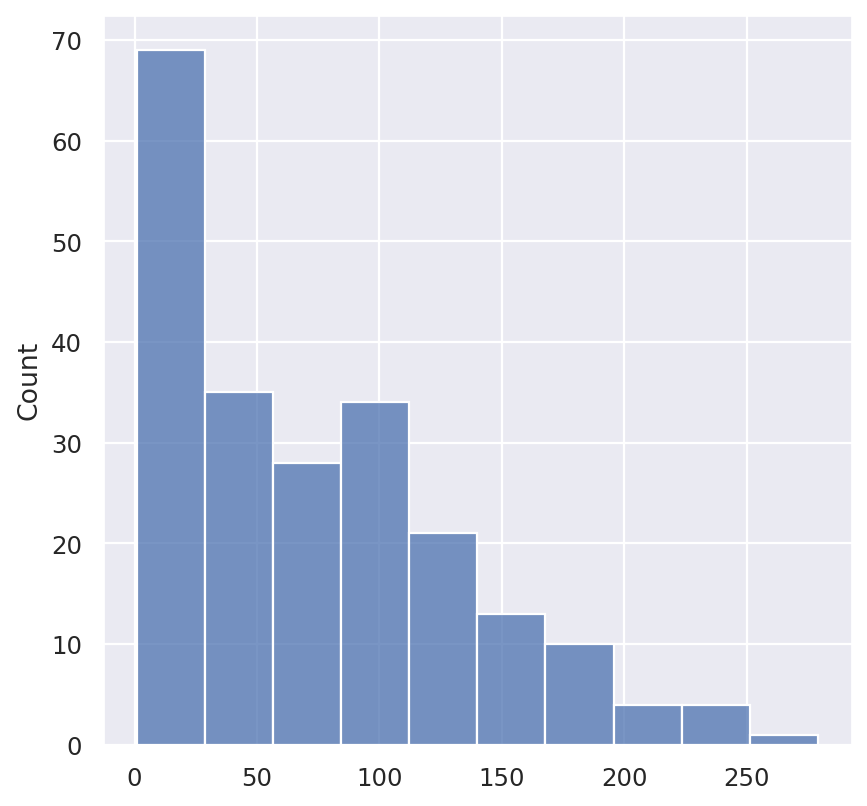

In [ ]:
Desc

In [14]:
nbhd_size.value_counts().sort_index().head(20)

Count
3      5
4      4
5      5
6      6
7      6
8      7
9     16
10     4
11     7
12     9
13    10
14     7
15    10
16     8
17     4
18     8
19     2
20     7
21     8
22     5
Name: count, dtype: int64

<Axes: ylabel='Count'>

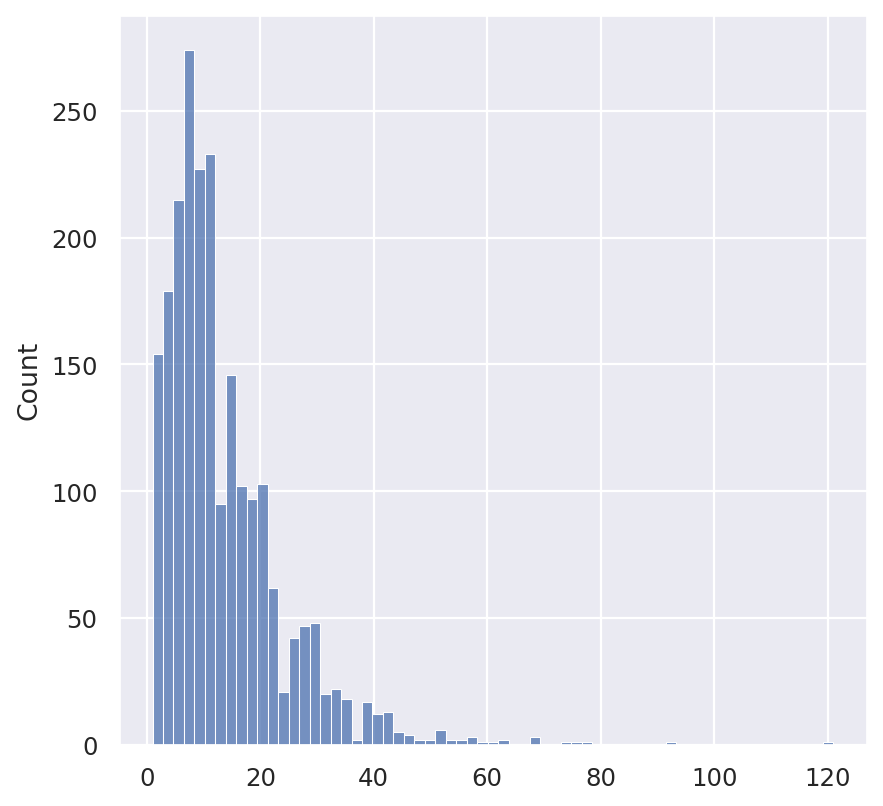

In [125]:
sns.histplot(g.dw)

In [115]:
np.array(pixel_size).reshape((1, -1)).repeat(C.shape[0], axis=0)

array([[ 8, 37,  1, ...,  1,  1,  1],
       [ 8, 37,  1, ...,  1,  1,  1],
       [ 8, 37,  1, ...,  1,  1,  1],
       ...,
       [ 8, 37,  1, ...,  1,  1,  1],
       [ 8, 37,  1, ...,  1,  1,  1],
       [ 8, 37,  1, ...,  1,  1,  1]])

In [ ]:
new_sizes.sum

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 1, 0, 0],
       [0, 0, 0, ..., 0, 1, 0],
       [0, 0, 0, ..., 0, 0, 1]])

58     1
149    1
148    1
161    1
157    1
155    1
71     1
68     1
66     1
174    1
153    1
55     1
54     1
51     1
50     1
184    1
179    1
49     1
48     1
92     1
dtype: int64

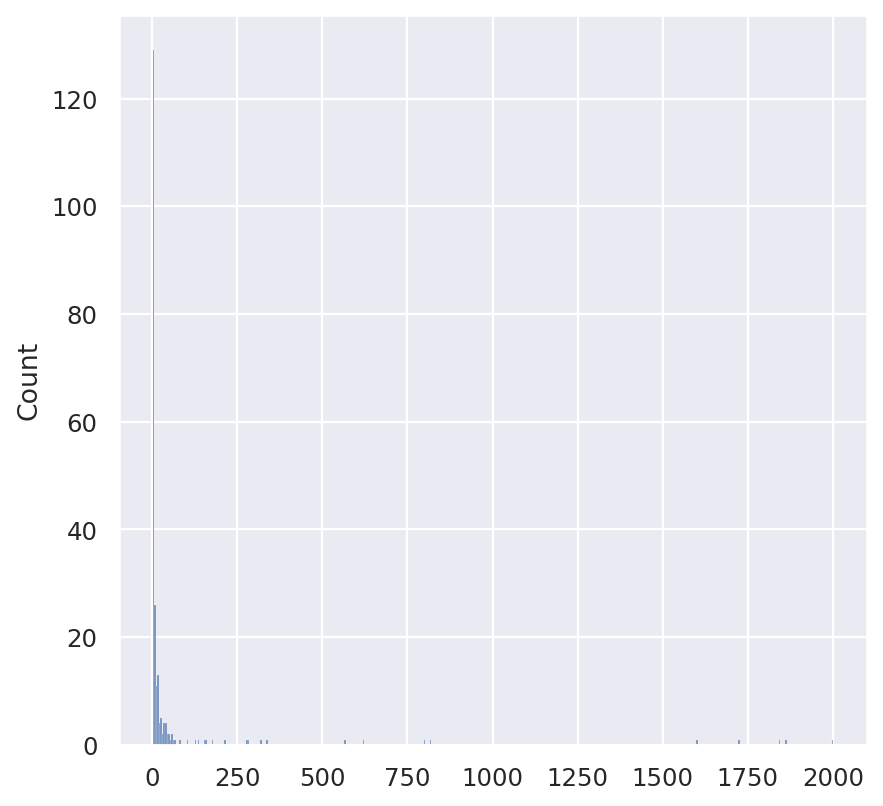

In [ ]:
from scipy.stats import pearsonr

size = (200,)
a = np.zeros(size, dtype=float)
a[0] = 0.1
a[1] = 0.1
b = np.random.normal(loc=0.3, scale=0.1, size=size)
pearsonr(a,b,)

In [ ]:
zip([str2pair(pair) for pair in highly_autocorr_pairs.index])

: 

: 

: 

NameError: name 'pd' is not defined

In [21]:
rantes_adata.obs.loc[comp, 'a_pixels'] + rantes_adata.obs.loc[comp, 'b_pixels']

1872

In [ ]:
edgelist = pg_data.edgelist
pixel_nbhd_counts = get_pixel_nbhd_counts(edgelist, rantes_adata, pixel_type='a', nbhd_radius=2, components=['RCVCMP0000067_sol_rantes'])

In [126]:
rantes_adata.to_df('counts').loc['RCVCMP0000067_sol_rantes', 'CD11c']

1

         m1      m2      corr            pair
840   CD162    CD37  0.752804    (CD162,CD37)
855   CD162    CD50  0.733326    (CD162,CD50)
3264   CD44    CD50  0.710094     (CD44,CD50)
2753   CD37    CD50  0.664492     (CD37,CD50)
847   CD162    CD44  0.654630    (CD162,CD44)
2745   CD37    CD44  0.640254     (CD37,CD44)
846   CD162    CD43  0.624529    (CD162,CD43)
2744   CD37    CD43  0.617728     (CD37,CD43)
3191   CD43    CD50  0.573450     (CD43,CD50)
3183   CD43    CD44  0.519520     (CD43,CD44)
2388   CD32    CD50  0.508014     (CD32,CD50)
305   CD11c    CD18  0.485563    (CD11c,CD18)
2380   CD32    CD44  0.473020     (CD32,CD44)
996    CD18  CD45RB  0.465678   (CD18,CD45RB)
2373   CD32    CD37  0.444882     (CD32,CD37)
2015  CD274    CD44  0.438208    (CD274,CD44)
4525   CD72  mIgG2b  0.434919   (CD72,mIgG2b)
2554  CD337  mIgG2b  0.395439  (CD337,mIgG2b)
341   CD11c    CD48  0.393147    (CD11c,CD48)
357   CD11c    CD86  0.383821    (CD11c,CD86)


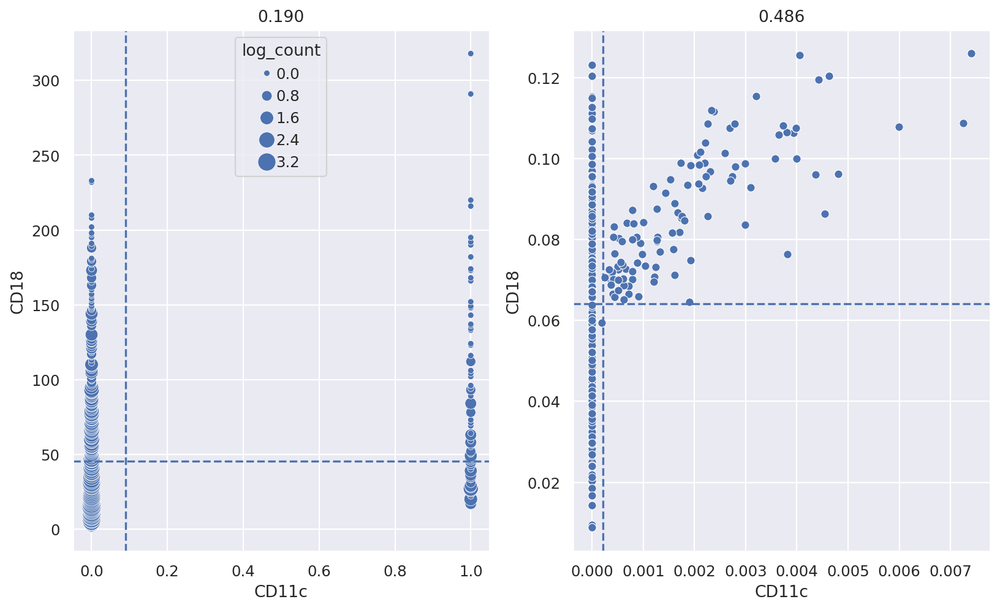

In [127]:
nbhd_counts = pixel_nbhd_counts['nbhd_counts'].pivot_table(index='nbhd_center_upi_int', columns='marker', values='Count', fill_value=0, observed=True).astype(int)
nbhd_total_counts = nbhd_counts.sum(axis=1)
large_nbhds = nbhd_total_counts[nbhd_total_counts > 100].index

nbhd_counts = nbhd_counts.loc[large_nbhds]
nbhd_means = nbhd_counts.mean(axis=0)

nbhd_counts_norm = nbhd_counts.div(nbhd_counts.sum(axis=1), axis=0)
nbhd_norm_means = nbhd_counts_norm.mean(axis=0)

nbhd_corr = nbhd_counts.corr()
nbhd_norm_corr = nbhd_counts_norm.corr()
nbhd_norm_corr_flat = flatten_corr(nbhd_norm_corr)
# sns.histplot(nbhd_norm_corr_flat)
print(nbhd_norm_corr_flat.sort_values(by='corr', ascending=False)[:20])

fig, ax = plt.subplots(1,2,figsize=(12,7))
# m1, m2 = 'CD162', 'CD37'
m1, m2 = 'CD11c', 'CD18'
# m1, m2 = 'CD162', 'CD50'
# m1, m2 = 'CD37', 'CD50'
# m1, m2 = 'B2M', 'HLA-DR'
df_agg = nbhd_counts.groupby([m1,m2]).size().reset_index(name='count')
df_agg['log_count'] = np.log(df_agg['count'])
# df_agg = df_agg[df_agg[m1] + df_agg[m2] > 0]


# Create a scatter plot where 'count' determines the marker size.
sns.scatterplot(data=df_agg, x=m1, y=m2, size='log_count', sizes=(20, 200), legend=True, ax=ax[0])
# sns.scatterplot(gld_a_counts,x='CD162',y='CD50', ax=ax[0])
sns.scatterplot(nbhd_counts_norm,x=m1,y=m2, ax=ax[1])
ax[0].set_title(f'{nbhd_corr.loc[m1,m2]:.3f}')
ax[1].set_title(f'{nbhd_norm_corr.loc[m1,m2]:.3f}')

for i, df in enumerate((nbhd_means, nbhd_norm_means)):
    ax[i].axhline(y=df[m2], linestyle='--')
    ax[i].axvline(x=df[m1], linestyle='--')

# print(len(large_nbhds) / len(nbhd_total_counts))
# sns.histplot(nbhd_total_counts, log_scale=True)

# pixel_nbhd_counts['nbhd_counts']

/tmp/ipykernel_1960594/3530775378.py:2: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  comp_pixel_counts = pd.pivot_table(pixel_counts[pixel_counts['component'] == comp], index='upi_int', columns='marker', values='Count').fillna(0).astype(int)


<Axes: xlabel='HLA-ABC', ylabel='Count'>

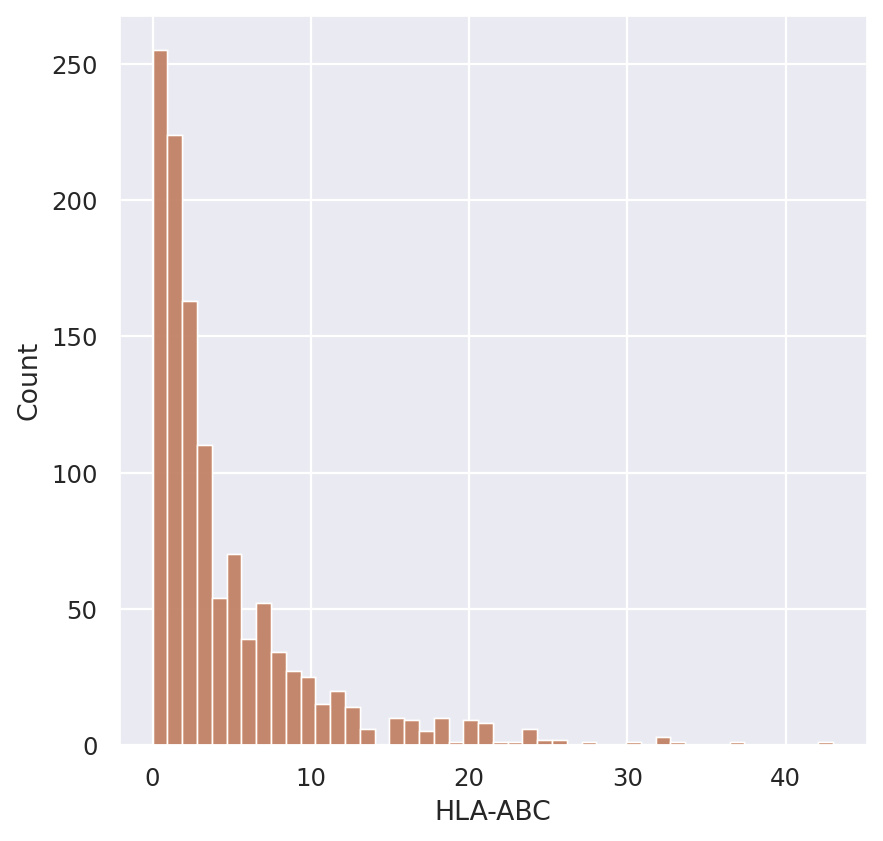

In [ ]:
comp = 'RCVCMP0000012_imm_rantes'
comp_pixel_counts = pd.pivot_table(pixel_counts[pixel_counts['component'] == comp], index='upi_int', columns='marker', values='Count').fillna(0).astype(int)

<Axes: xlabel='CD8', ylabel='Count'>

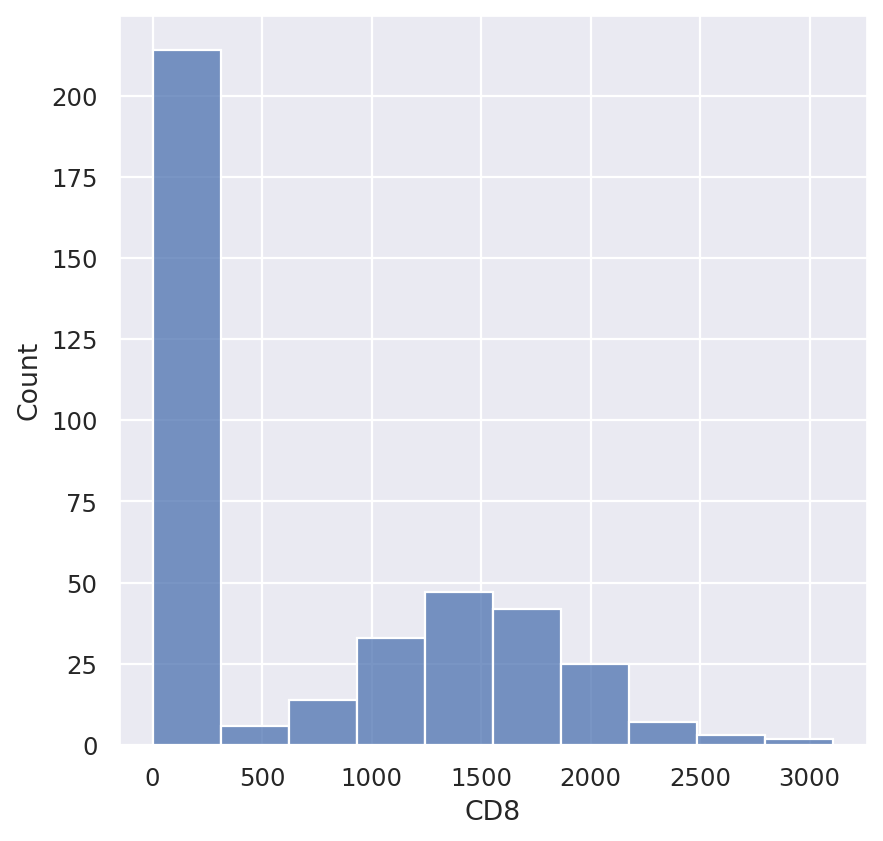

In [47]:
rantes_adata.to_df('counts')['CD8']

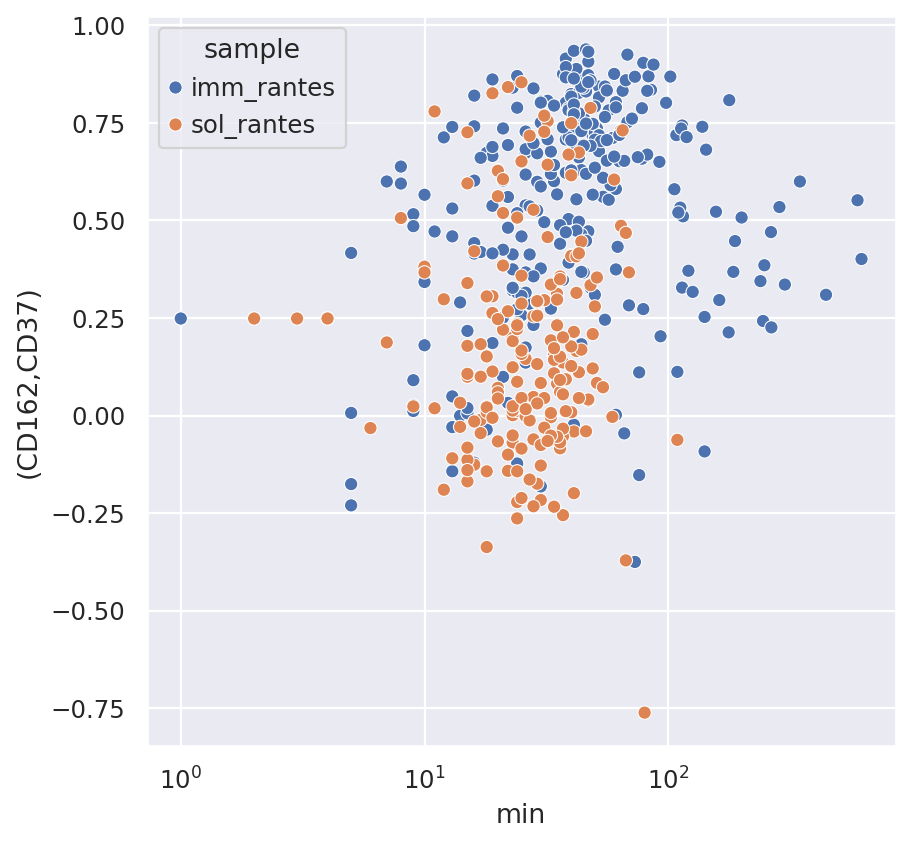

In [75]:
m1, m2 = 'CD162', 'CD37'
# m1, m2 = 'B2M', 'HLA-ABC'
pair = pair2str(m1, m2, sort=True)
counts_df = rantes_adata.to_df('counts')
min_counts = rantes_adata.to_df('counts').min(axis=0)
coloc_p_df = rantes_adata.obsm['coloc_p'].copy()
coloc_p_df['sample'] = rantes_adata.obs['sample']
coloc_p_df['min'] = np.minimum(counts_df[m1], counts_df[m2])
# sns.histplot(coloc_p_df, x=pair, hue='sample')
ax = sns.scatterplot(coloc_p_df, x='min', y=pair, hue='sample',)
ax.set_xscale('log')

RCVCMP0000067_sol_rantes 0.8540750036522617
0.507453013609851


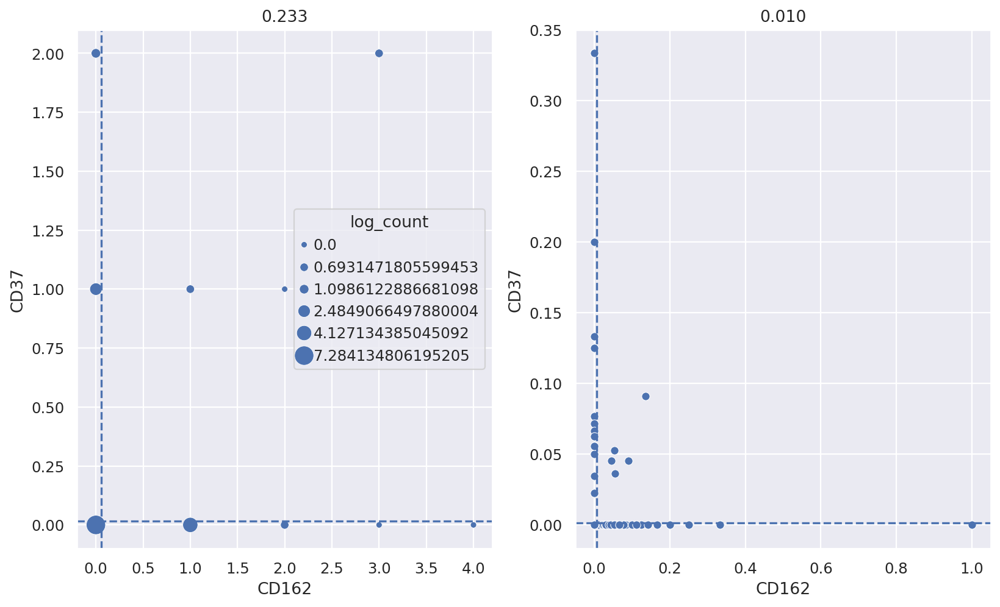

In [99]:
# comp = adata.obsm['coloc_p']['(B2M,HLA-ABC)'].sort_values(ascending=False).index[0]
m1, m2 = 'CD162', 'CD37'
pair = pair2str(m1,m2,sort=True)


comp = adata.obsm['coloc_p'].loc[adata.obs[adata.obs['sample'] == 'sol_rantes'].index][pair].sort_values(ascending=False).index[0]
# comp = 'RCVCMP0000012_imm_rantes'

print(comp, adata.obsm['coloc_p'].loc[comp, pair])

gld = compute_graph_layout(pg_data, comp)
gld_a = gld[gld['pixel_type'] == 'A']
# gld_a_counts.mean(axis=0).sort_values(ascending=False).head(20)
# gld_a_counts.corr('pearson')
# sns.scatterplot(gld_a_counts,x='B2M',y='HLA-ABC')
# gld_a_counts_norm = gld_a_counts / gld_a_counts.sum(axis=1)

gld_a_counts = gld_a.iloc[:,:77]
gld_a_pixel_sum = gld_a_counts.sum(axis=1)

# sns.histplot(gld_a_pixel_sum)

large_pixels = gld_a_pixel_sum[gld_a_pixel_sum > 5].index

print(len(large_pixels) / len(gld_a_pixel_sum))

# gld_a_counts = gld_a_counts.loc[large_pixels, :]



gld_a_counts_norm = gld_a_counts.div(gld_a_counts.sum(axis=1), axis=0)

gld_a_means = gld_a_counts.mean(axis=0)
gld_a_norm_means = gld_a_counts_norm.mean(axis=0)

corr = gld_a_counts.corr('pearson')
corr_norm = gld_a_counts_norm.corr('pearson')

def flatten_corr(corr):
    corr_flat = corr.stack().rename_axis(('m1','m2')).reset_index(name='corr')
    corr_flat = corr_flat[corr_flat['m1'] != corr_flat['m2']]
    corr_flat['pair'] = [pair2str(m1,m2,sort=True) for m1,m2 in zip(corr_flat['m1'], corr_flat['m2'])]
    corr_flat.drop_duplicates(subset='pair', inplace=True)
    return corr_flat

corr_flat = flatten_corr(corr)
corr_norm_flat = flatten_corr(corr_norm)

fig, ax = plt.subplots(1,2,figsize=(12,7))
# m1, m2 = 'CD162', 'CD37'
# m1, m2 = 'CD162', 'CD50'
# m1, m2 = 'CD37', 'CD50'
# m1, m2 = 'B2M', 'HLA-DR'
df_agg = gld_a_counts.groupby([m1,m2]).size().reset_index(name='count')
df_agg['log_count'] = np.log(df_agg['count'])
# df_agg = df_agg[df_agg[m1] + df_agg[m2] > 0]


# Create a scatter plot where 'count' determines the marker size.
sns.scatterplot(data=df_agg, x=m1, y=m2, size='log_count', sizes=(20, 200), legend=True, ax=ax[0])
# sns.scatterplot(gld_a_counts,x='CD162',y='CD50', ax=ax[0])
sns.scatterplot(gld_a_counts_norm,x=m1,y=m2, ax=ax[1])
ax[0].set_title(f'{corr.loc[m1,m2]:.3f}')
ax[1].set_title(f'{corr_norm.loc[m1,m2]:.3f}')

for i, df in enumerate((gld_a_means, gld_a_norm_means)):
    ax[i].axhline(y=df[m2], linestyle='--')
    ax[i].axvline(x=df[m1], linestyle='--')

In [ ]:
sns.histplot()

In [64]:
from sklearn.feature_selection import mutual_info_regression

def mutual_info(df, vars=None):
    if vars is None:
        vars = df.columns
    mutual_info_matrix = np.zeros((len(vars), len(vars)))

    for i, var1 in enumerate(vars):
        for j, var2 in enumerate(vars):
            X = df[[var1]]
            y = df[var2]
            mutual_info = mutual_info_regression(X, y)
            mutual_info_matrix[i, j] = mutual_info[0]

    mutual_info_df = pd.DataFrame(mutual_info_matrix, index=vars, columns=vars)

    return mutual_info_df    

In [67]:
# mutual_info_norm = mutual_info(gld_a_counts_norm)

0.3575168287210172
0.054055108629301366
0.0033148591401791793


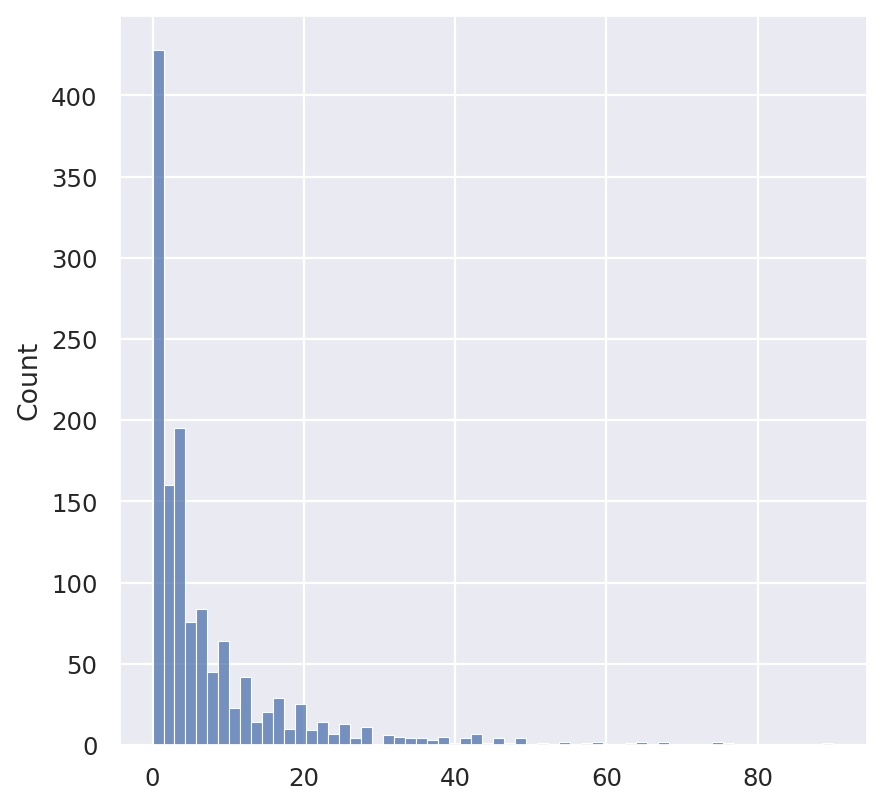

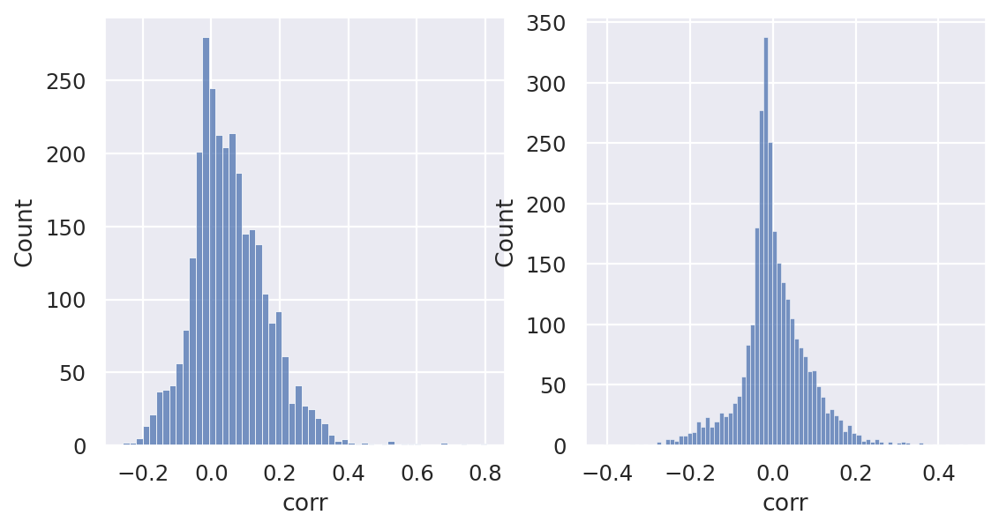

In [60]:
# sns.histplot(rantes_adata.to_df('counts')['CD162'])
# comp = rantes_adata.obs.index[100]
comp = adata.obsm['coloc_p']['(B2M,HLA-ABC)'].sort_values(ascending=False).index[0]
# print(rantes_adata.to_df('counts').loc[comp, 'CD162'])
gld = compute_graph_layout(pg_data, comp)
gld_a = gld[gld['pixel_type'] == 'A']
# gld_a_counts.mean(axis=0).sort_values(ascending=False).head(20)
# gld_a_counts.corr('pearson')
# sns.scatterplot(gld_a_counts,x='B2M',y='HLA-ABC')
# gld_a_counts_norm = gld_a_counts / gld_a_counts.sum(axis=1)

gld_a_counts = gld_a.iloc[:,:77]
gld_a_pixel_sum = gld_a_counts.sum(axis=1)

sns.histplot(gld_a_pixel_sum)

large_pixels = gld_a_pixel_sum[gld_a_pixel_sum > 5].index

print(len(large_pixels) / len(gld_a_pixel_sum))

gld_a_counts = gld_a_counts.loc[large_pixels, :]



gld_a_counts_norm = gld_a_counts.div(gld_a_counts.sum(axis=1), axis=0)

gld_a_means = gld_a_counts.mean(axis=0)
gld_a_norm_means = gld_a_counts_norm.mean(axis=0)





corr = gld_a_counts.corr('pearson')
corr_norm = gld_a_counts_norm.corr('pearson')

def flatten_corr(corr):
    corr_flat = corr.stack().rename_axis(('m1','m2')).reset_index(name='corr')
    corr_flat = corr_flat[corr_flat['m1'] != corr_flat['m2']]
    corr_flat['pair'] = [pair2str(m1,m2,sort=True) for m1,m2 in zip(corr_flat['m1'], corr_flat['m2'])]
    corr_flat.drop_duplicates(subset='pair', inplace=True)
    return corr_flat

corr_flat = flatten_corr(corr)
corr_norm_flat = flatten_corr(corr_norm)

# print(corr_flat)

fig, ax = plt.subplots(1,2,figsize=(8,4))
sns.histplot(corr_flat['corr'], ax=ax[0])
sns.histplot(corr_norm_flat['corr'], ax=ax[1])

print(corr_flat['corr'].mean())
print(corr_norm_flat['corr'].mean())

# markers = corr.columns
# coloc_comp = []
# index = []
# for m1 in markers:
#     for m2 in markers:
#         if m2 <= m1:
#             continue
#         coloc_comp.append(corr.loc[m1,m2])
#         index.append(pair2str(m1,m2,sort=True))
# coloc_comp = pd.Series(coloc_comp, index=index)
# sns.histplot(coloc_comp)
# coloc_comp['(CD162,CD50)']
# sns.scatterplot(gld_a_counts_norm,x='B2M',y='HLA-DR')




In [12]:
autocorr = distr_autocorrelation_in_latent(rantes_adata, latent_neighbors_connectivities_key_lst=['multi_model_coloc_connectivities'], 
                                           names=['Multi Model (Coloc Latent)'], distr_key='coloc_p_unit')
highly_autocorr_pairs = autocorr.sort_values(by='morans', ascending=False)
m1, m2 = zip(*[str2pair(pair) for pair in highly_autocorr_pairs.index])
highly_autocorr_pairs['m1'] = m1
highly_autocorr_pairs['m2'] = m2
# # for pair in highly_autocorr_pairs.index:
# #     m1, m2 = str2pair(pair)
# #     highly_autocorr_pairs['m1'] = m1
# #     highly_autocorr_pairs['m2'] = m2
highly_autocorr_pairs['m1_mean'] = highly_autocorr_pairs['m1'].map(rantes_adata.to_df('counts').mean(axis=0))
highly_autocorr_pairs['m2_mean'] = highly_autocorr_pairs['m2'].map(rantes_adata.to_df('counts').mean(axis=0))

print(highly_autocorr_pairs.head(20))

                   morans    gearys                      latent     m1  \
(CD162,CD50)     0.666743  0.350598  Multi Model (Coloc Latent)  CD162   
(CD162,CD37)     0.643095  0.354515  Multi Model (Coloc Latent)  CD162   
(CD37,CD50)      0.637319  0.341304  Multi Model (Coloc Latent)   CD37   
(CD162,CD44)     0.516930  0.468253  Multi Model (Coloc Latent)  CD162   
(CD44,CD50)      0.512497  0.457954  Multi Model (Coloc Latent)   CD44   
(CD18,CD50)      0.507135  0.478654  Multi Model (Coloc Latent)   CD18   
(CD37,CD44)      0.497977  0.474156  Multi Model (Coloc Latent)   CD37   
(CD162,CD18)     0.482227  0.519669  Multi Model (Coloc Latent)  CD162   
(CD18,CD37)      0.474713  0.520908  Multi Model (Coloc Latent)   CD18   
(CD50,HLA-ABC)   0.455955  0.502771  Multi Model (Coloc Latent)   CD50   
(CD11a,CD19)     0.435903  0.428351  Multi Model (Coloc Latent)  CD11a   
(CD19,CD40)      0.428000  0.454487  Multi Model (Coloc Latent)   CD19   
(CD11b,CD337)    0.419775  0.516143  M

In [ ]:
compute_graph_layout(pg_data, )

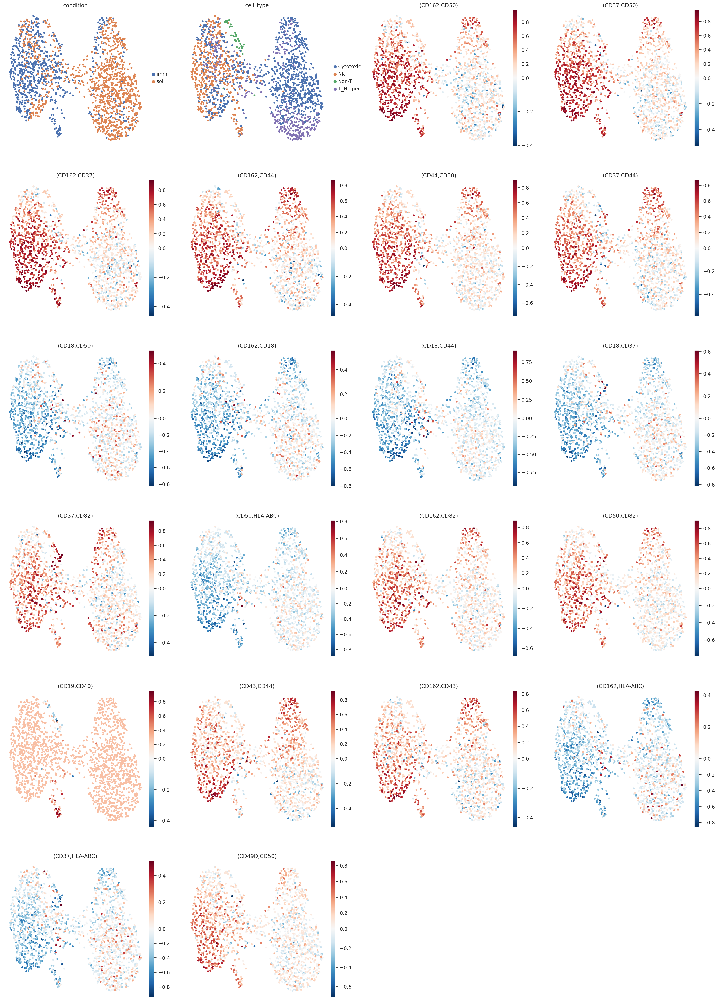

In [83]:
autocorr = distr_autocorrelation_in_latent(adata, latent_neighbors_connectivities_key_lst=['multi_model_coloc_connectivities'], 
                                           names=['Multi Model (Coloc Latent)'], distr_key='coloc_p_unit')
highly_autocorr_pairs = list(autocorr.sort_values(by='morans', ascending=False)[0:20].index)
for pair in highly_autocorr_pairs:
    # adata.obs[pair] = adata.obsm['coloc_p'][pair]
    ada

# fig = pca_neighbors_umap(adata, latent_name, umap_pl_kwargs=dict(color=['sample', 'cell_type', *highly_autocorr_pairs], vcenter=0, cmap='RdBu_r'), )

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/lightning/pytorch/loops/fit_loop.py:310: The number of training batches (1) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training:   0%|          | 0/10000 [00:00<?, ?it/s]

Monitored metric elbo_validation did not improve in the last 200 records. Best score: 80.476. Signaling Trainer to stop.


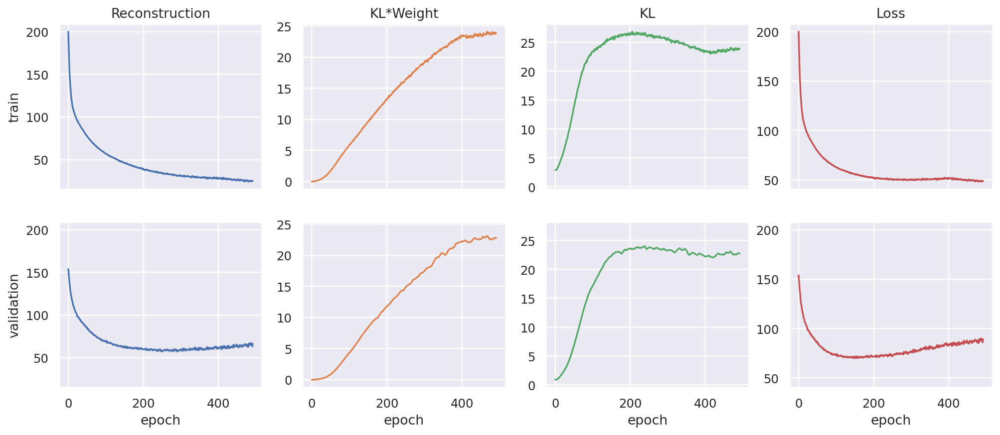

In [17]:
EPOCHS = 10000
train_kwargs = dict(train_size=0.8, check_val_every_n_epoch=1, early_stopping=True, early_stopping_patience=200, batch_size=2000, n_epochs_kl_warmup=400, lr=1e-3,
                    max_epochs=EPOCHS, enable_checkpointing=True, plan_kwargs=dict(optimizer='Adam'))
model_kwargs = dict(n_latent=20, n_hidden=128, n_layers=1, dropout_rate=0.1, prior_mixture=False)
model_cls = CytoVI
model_cls.setup_anndata(adata, layer='dsb', batch_key='sample',)
model = model_cls(adata, **model_kwargs)
model.train(**train_kwargs)
ax = plot_losses(model,)

In [18]:
polarization = convert_polarization_to_feature_matrix(pg_data.polarization, components=adata.obs.index, key='morans_i', fill_na_with_mean=True)
# polarization = np.log1p(polarization)
adata.obsm['polarization_morans_i'] = polarization.reindex(adata.obs.index)
polarization = adata.obsm['polarization_morans_i']
adata.obs['CD162_pol'] = adata.obsm['polarization_morans_i']['CD162_pol']
adata.obsm['polarization_morans_i']

,ACTB_pol,B2M_pol,CD102_pol,CD11a_pol,CD11b_pol,CD11c_pol,CD127_pol,CD137_pol,CD14_pol,CD150_pol,...,CD82_pol,CD84_pol,CD86_pol,CD9_pol,HLA-ABC_pol,HLA-DR_pol,TCRVb5_pol,mIgG1_pol,mIgG2a_pol,mIgG2b_pol
component,,,,,,,,,,,,,,,,,,,,,
RCVCMP0000012_imm_rantes,0.041592,-0.015353,-0.003729,-0.006783,0.013447,-0.009634,0.004143,0.030859,0.048798,-0.000451,...,0.008261,0.007894,-0.003623,0.030321,-0.029365,-0.017168,-0.009841,0.006880,-0.004233,-0.003420
RCVCMP0000013_imm_rantes,0.031865,0.088864,0.012725,0.028231,0.004943,0.016342,0.008538,0.014973,0.041452,0.007539,...,0.048534,0.003433,0.054577,0.023241,0.112942,0.189797,0.002530,0.002693,0.003327,0.008250
RCVCMP0000018_imm_rantes,0.018778,0.106305,-0.011280,-0.010683,0.013447,0.097657,0.116950,0.030859,0.149549,0.020461,...,0.032200,0.008348,0.001210,0.030321,0.085089,0.062718,0.087174,0.006880,-0.005200,-0.005730
RCVCMP0000020_imm_rantes,0.084649,0.193289,0.011483,-0.002505,0.027488,0.020582,0.023251,0.037301,0.035482,0.028799,...,0.001438,0.015594,-0.002651,0.055438,0.359677,0.037842,0.005275,0.012067,0.015399,0.010423
RCVCMP0000021_imm_rantes,0.212704,0.128088,0.033653,0.114082,0.082606,0.132631,0.150013,0.030859,0.139659,0.145829,...,0.060347,0.240261,0.019910,0.123492,0.174178,0.063315,0.330841,0.101395,0.065154,0.111031
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
RCVCMP0000511_sol_rantes,0.041592,-0.006234,0.007111,-0.001005,0.013447,0.008031,-0.015191,0.030859,0.048798,0.020461,...,-0.000444,-0.002203,0.002615,0.030321,-0.004344,0.011635,0.004638,0.006880,-0.003292,0.002092
RCVCMP0000536_sol_rantes,0.041592,-0.001259,0.006264,0.012733,0.013447,0.008031,-0.001774,0.030859,0.048798,0.020461,...,0.006992,0.027112,0.003794,-0.006139,-0.017669,0.015095,0.004638,0.006880,0.003200,-0.003592
RCVCMP0000547_sol_rantes,0.041592,0.004280,0.001613,-0.016979,0.013447,0.008031,-0.007220,0.030859,0.048798,0.020461,...,-0.004580,0.002366,0.005904,0.030321,-0.010732,0.000795,-0.005605,0.006880,0.002963,0.002092


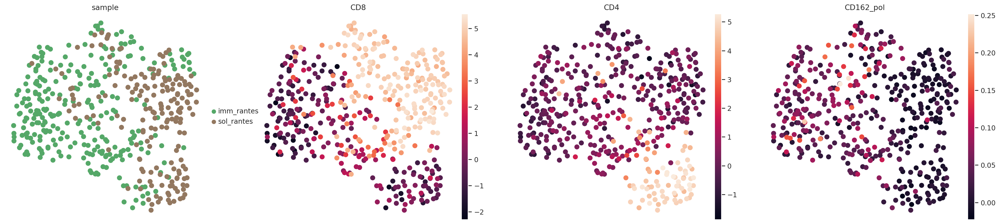

In [19]:
adata.obsm['model_latent'] = model.get_latent_representation()
sc.pp.neighbors(adata, use_rep='model_latent', key_added='model_latent')
sc.tl.umap(adata, neighbors_key='model_latent')
sc.pl.umap(adata, layer='dsb', color=['sample', 'CD8', 'CD4', 'CD162_pol'])

In [20]:
joint_df = pd.concat((adata.to_df('dsb'), polarization), axis=1)
# joint_df = center_feature_matrix(joint_df) 
joint_adata = anndata.AnnData(
    X=joint_df,
    obs=adata.obs
)
pol_adata = anndata.AnnData(
    X=polarization,
    obs=adata.obs
)
joint_adata.to_df()

,B2M,CD102,CD11a,CD11b,CD11c,CD127,CD137,CD14,CD150,CD152,...,CD82_pol,CD84_pol,CD86_pol,CD9_pol,HLA-ABC_pol,HLA-DR_pol,TCRVb5_pol,mIgG1_pol,mIgG2a_pol,mIgG2b_pol
component,,,,,,,,,,,,,,,,,,,,,
RCVCMP0000012_imm_rantes,0.217435,-0.023725,-1.091946,0.436238,0.641175,0.397161,0.218168,0.625346,1.389450,0.966076,...,0.008261,0.007894,-0.003623,0.030321,-0.029365,-0.017168,-0.009841,0.006880,-0.004233,-0.003420
RCVCMP0000013_imm_rantes,1.322622,2.098635,2.224566,-0.063806,0.475942,1.309431,-0.095579,-0.143379,-0.167313,0.378149,...,0.048534,0.003433,0.054577,0.023241,0.112942,0.189797,0.002530,0.002693,0.003327,0.008250
RCVCMP0000018_imm_rantes,0.280743,-0.388274,0.158085,0.912124,0.744083,0.914994,1.095528,1.829137,0.651945,0.714511,...,0.032200,0.008348,0.001210,0.030321,0.085089,0.062718,0.087174,0.006880,-0.005200,-0.005730
RCVCMP0000020_imm_rantes,0.185710,0.551910,1.919032,1.147919,0.915591,2.087785,1.312298,1.262899,0.471278,0.457130,...,0.001438,0.015594,-0.002651,0.055438,0.359677,0.037842,0.005275,0.012067,0.015399,0.010423
RCVCMP0000021_imm_rantes,0.193985,-0.070187,0.700470,0.887372,1.206676,0.321251,0.003316,1.342488,0.688384,1.863046,...,0.060347,0.240261,0.019910,0.123492,0.174178,0.063315,0.330841,0.101395,0.065154,0.111031
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
RCVCMP0000511_sol_rantes,0.010078,0.721854,2.792248,0.375776,-0.309205,1.879095,0.602572,1.108908,0.911159,-0.362726,...,-0.000444,-0.002203,0.002615,0.030321,-0.004344,0.011635,0.004638,0.006880,-0.003292,0.002092
RCVCMP0000536_sol_rantes,0.092828,0.572489,2.981829,-0.746559,0.230919,2.113833,-0.568778,-0.185795,-0.326864,-0.711840,...,0.006992,0.027112,0.003794,-0.006139,-0.017669,0.015095,0.004638,0.006880,0.003200,-0.003592
RCVCMP0000547_sol_rantes,0.182790,0.334625,3.469486,0.630735,0.607404,2.685848,0.886648,0.773116,1.234843,0.943278,...,-0.004580,0.002366,0.005904,0.030321,-0.010732,0.000795,-0.005605,0.006880,0.002963,0.002092


In [ ]:
scvi.model.MULTIVI

INFO     Using column names from columns of adata.obsm['polarization_morans_i']                                    


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/lightning/pytorch/loops/fit_loop.py:310: The number of training batches (1) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training:   0%|          | 0/10000 [00:00<?, ?it/s]

Monitored metric elbo_validation did not improve in the last 200 records. Best score: -89.230. Signaling Trainer to stop.


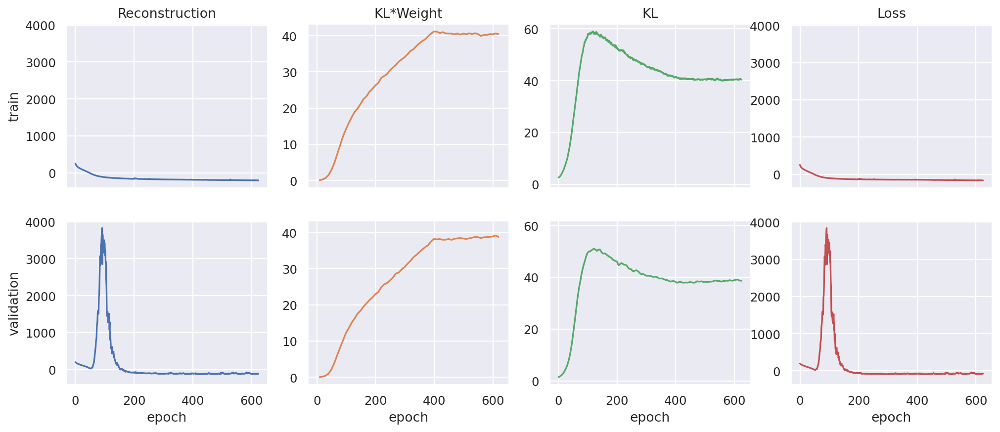

In [36]:
EPOCHS = 10000

obsm_extra_modality_keys=['polarization_morans_i']

model_cls = NormalSCVI
train_kwargs = dict(train_size=0.8, check_val_every_n_epoch=1, early_stopping=True, early_stopping_patience=200, batch_size=1000, 
                    max_epochs=EPOCHS, enable_checkpointing=True, plan_kwargs=dict(optimizer='Adam', n_epochs_kl_warmup=400, lr=1e-3,))
model_kwargs = dict(n_latent=20, n_hidden=128, n_layers=1, dropout_rate=0.1, n_extra_modalities=1, obsm_extra_modality_keys=obsm_extra_modality_keys, weights=[0.9, 0.1])
model_cls.setup_anndata(adata, layer='dsb', batch_key='sample', obsm_extra_modality_keys=obsm_extra_modality_keys)
multi_model = model_cls(adata, **model_kwargs)
# print(normal_joint_model)
multi_model.train(**train_kwargs)
ax = plot_losses(multi_model)

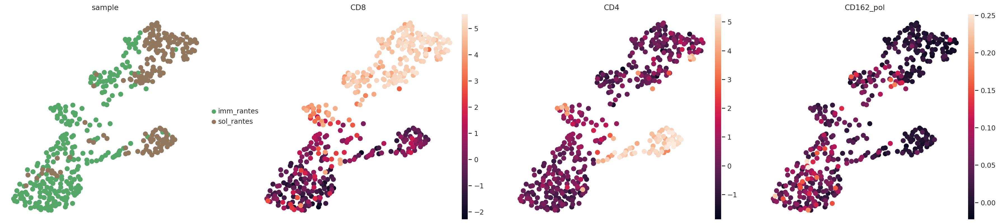

In [37]:
adata.obsm['multi_model_latent'] = multi_model.get_latent_representation()
sc.pp.neighbors(adata, use_rep='multi_model_latent', key_added='multi_model_latent')
sc.tl.umap(adata, neighbors_key='multi_model_latent')
sc.pl.umap(adata, layer='dsb', color=['sample', 'CD8', 'CD4', 'CD162_pol'])

Normal SCVI Model with the following params: 
n_latent: 20
n_extra_modalities: 0
weights: tensor([1.], dtype=torch.float64)
input_ds: [160]
Training status: Not Trained

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/lightning/pytorch/loops/fit_loop.py:310: The number of training batches (1) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training:   0%|          | 0/10000 [00:00<?, ?it/s]

Monitored metric elbo_validation did not improve in the last 200 records. Best score: -100.866. Signaling Trainer to stop.


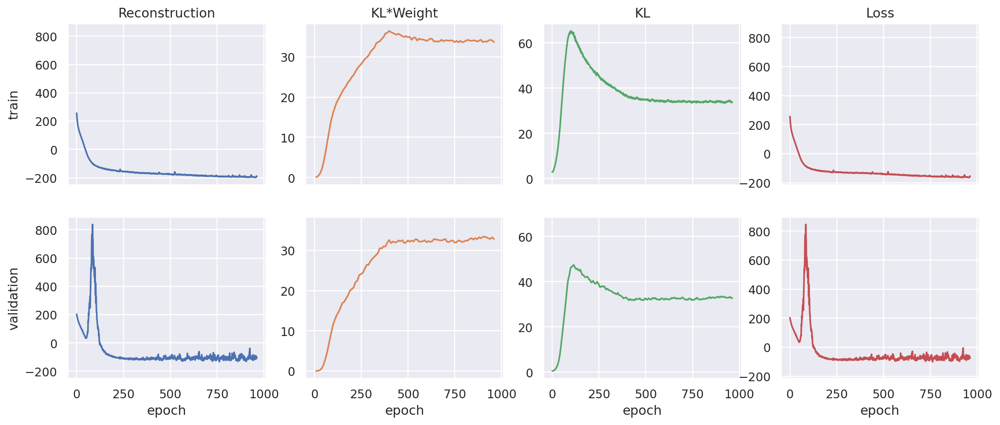

In [185]:
EPOCHS = 10000

# model_cls = CytoVI
# train_kwargs = dict(train_size=0.8, check_val_every_n_epoch=1, early_stopping=True, early_stopping_patience=200, batch_size=1000, n_epochs_kl_warmup=400, lr=1e-3,
#                     max_epochs=EPOCHS, enable_checkpointing=True, plan_kwargs=dict(optimizer='Adam'))
# model_kwargs = dict(n_latent=20, n_hidden=128, n_layers=1, dropout_rate=0.1, prior_mixture=False)
# model_cls.setup_anndata(joint_adata, batch_key='sample',)
# cyto_joint_model = model_cls(joint_adata, **model_kwargs)
# cyto_joint_model.train(**train_kwargs)
# ax = plot_losses(cyto_joint_model)


model_cls = NormalSCVI
train_kwargs = dict(train_size=0.8, check_val_every_n_epoch=1, early_stopping=True, early_stopping_patience=200, batch_size=1000, 
                    max_epochs=EPOCHS, enable_checkpointing=True, plan_kwargs=dict(optimizer='Adam', n_epochs_kl_warmup=400, lr=1e-3,))
model_kwargs = dict(n_latent=20, n_hidden=128, n_layers=1, dropout_rate=0.1)
model_cls.setup_anndata(joint_adata, batch_key='sample',)
normal_joint_model = model_cls(joint_adata, **model_kwargs)
print(normal_joint_model)
normal_joint_model.train(**train_kwargs)
ax = plot_losses(normal_joint_model)

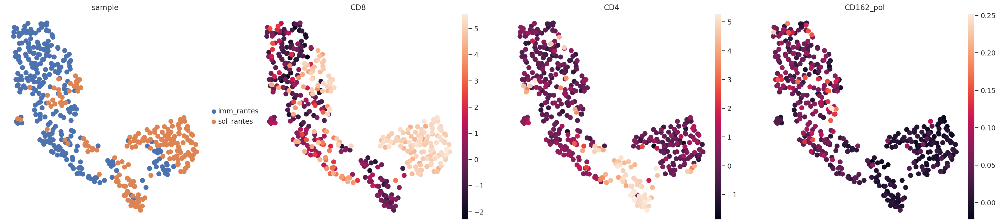

In [186]:
# joint_adata.obsm['cyto_model_latent'] = cyto_joint_model.get_latent_representation()
# sc.pp.neighbors(joint_adata, use_rep='cyto_model_latent', key_added='cyto_model_latent')
# sc.tl.umap(joint_adata, neighbors_key='cyto_model_latent')
# # joint_adata.obs.drop(columns='CD162_pol', inplace=True)
# sc.pl.umap(joint_adata, color=['sample', 'CD8', 'CD4', 'CD162_pol'])

joint_adata.obsm['normal_model_latent'] = normal_joint_model.get_latent_representation()
sc.pp.neighbors(joint_adata, use_rep='normal_model_latent', key_added='normal_model_latent')
sc.tl.umap(joint_adata, neighbors_key='normal_model_latent')
# joint_adata.obs.drop(columns='CD162_pol', inplace=True)
sc.pl.umap(joint_adata, color=['sample', 'CD8', 'CD4', 'CD162_pol'])

## Latent space concatenation

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/lightning/pytorch/loops/fit_loop.py:310: The number of training batches (1) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training:   0%|          | 0/10000 [00:00<?, ?it/s]

Monitored metric elbo_validation did not improve in the last 20 records. Best score: -164.997. Signaling Trainer to stop.


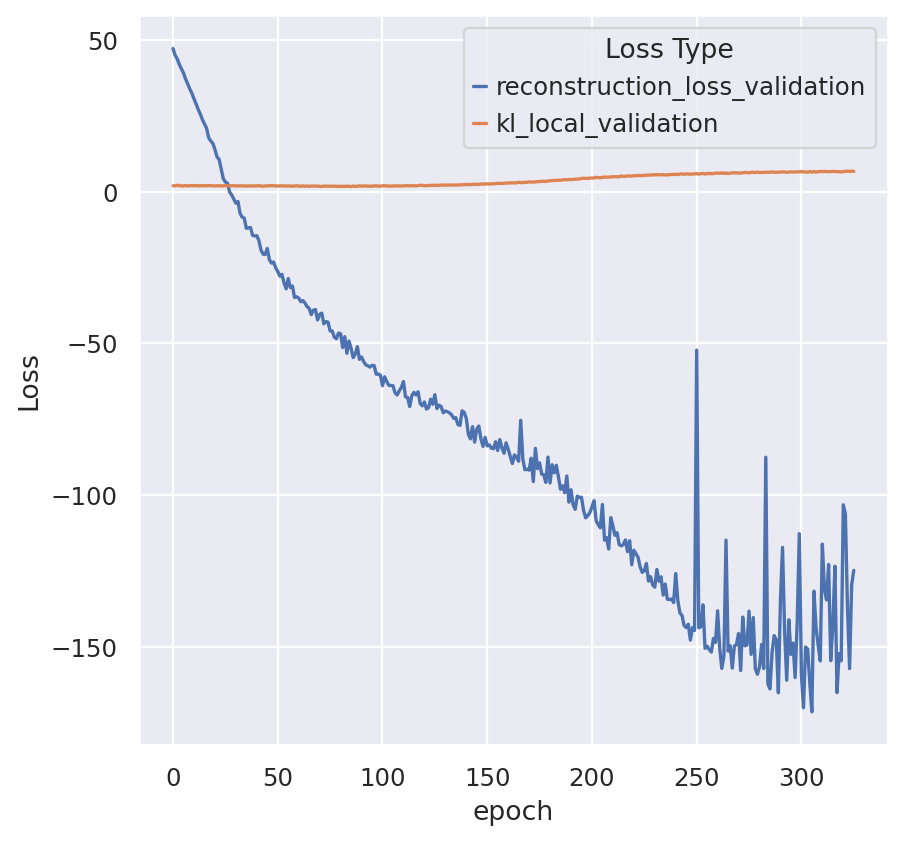

In [19]:
EPOCHS = 10000
train_kwargs = dict(train_size=0.8, check_val_every_n_epoch=1, early_stopping=True, early_stopping_patience=20, batch_size=1000,
                    max_epochs=EPOCHS, enable_checkpointing=True, plan_kwargs=dict(lr=3e-4, optimizer='Adam', n_epochs_kl_warmup=0))
model_kwargs = dict(n_latent=10, n_hidden=128, n_layers=1, dropout_rate=0.1, prior_mixture=True)
model_cls.setup_anndata(pol_adata, batch_key='sample',)
pol_model = model_cls(pol_adata, **model_kwargs)
pol_model.train(**train_kwargs)
ax = plot_validation_loss(pol_model, semilogy=False)

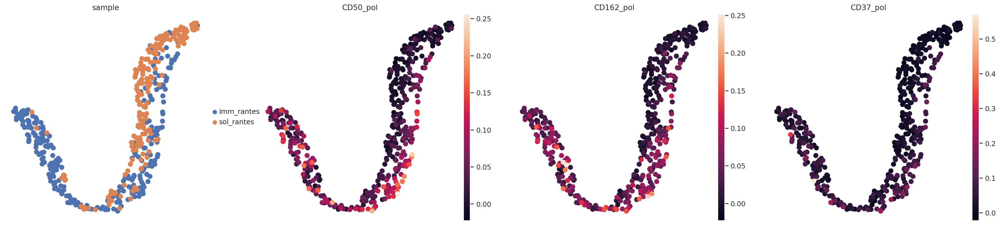

In [21]:
pol_adata.obsm['model_latent'] = pol_model.get_latent_representation()
sc.pp.neighbors(pol_adata, use_rep='model_latent', key_added='model_latent')
sc.tl.umap(pol_adata, neighbors_key='model_latent')
pol_adata.obs.drop(columns='CD162_pol', inplace=True)
sc.pl.umap(pol_adata, color=['sample', 'CD50_pol', 'CD162_pol', 'CD37_pol'])

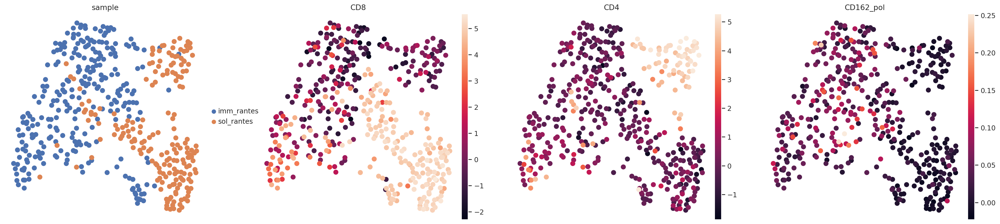

In [23]:
adata.obsm['concat_latent'] = np.concatenate((adata.obsm['model_latent'], pol_adata.obsm['model_latent']), axis=1)
sc.pp.neighbors(adata, use_rep='concat_latent', key_added='concat_latent')
sc.tl.umap(adata, neighbors_key='concat_latent')
sc.pl.umap(adata, layer='dsb', color=['sample', 'CD8', 'CD4', 'CD162_pol'])

In [211]:
joint_adata.layers['decoded'] = joint_model.get_normalized_expression()

In [212]:
sc.tl.rank_genes_groups(joint_adata, groupby='sample', layer='decoded', use_raw=False, method='wilcoxon')
joint_de = sc.get.rank_genes_groups_df(joint_adata, group='imm_rantes', pval_cutoff=0.05)
# sc.pl.rank_genes_groups_dotplot(joint_adata, n_genes=10, values_to_plot="pvals_adj", )
signficant_de = joint_de['names']
polarized_significant_markers = [m.split('_')[0] for m in signficant_de if 'pol' in m]
significant_markers = [m for m in signficant_de if 'pol' not in m]
print(len(polarized_significant_markers))
print(len(significant_markers))
print(sorted(list(set(polarized_significant_markers).intersection(set(significant_markers)))))
print(sorted(list(set(polarized_significant_markers).difference(set(significant_markers)))))


60
64
['CD102', 'CD11b', 'CD11c', 'CD127', 'CD154', 'CD16', 'CD161', 'CD162', 'CD163', 'CD18', 'CD197', 'CD20', 'CD22', 'CD244', 'CD25', 'CD26', 'CD27', 'CD274', 'CD278', 'CD32', 'CD328', 'CD36', 'CD37', 'CD4', 'CD40', 'CD45RA', 'CD47', 'CD48', 'CD49D', 'CD50', 'CD52', 'CD53', 'CD54', 'CD55', 'CD59', 'CD7', 'CD72', 'CD8', 'CD82', 'CD86', 'HLA-ABC', 'HLA-DR', 'TCRVb5', 'mIgG1', 'mIgG2a', 'mIgG2b']
['ACTB', 'B2M', 'CD14', 'CD2', 'CD200', 'CD229', 'CD279', 'CD337', 'CD35', 'CD38', 'CD41', 'CD62P', 'CD71', 'CD84']


/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(


In [ ]:
components_to_keep = pg_data_combined_pxl_object.adata[
    (pg_data_combined_pxl_object.adata.obs["molecules"] >= 10000)
    & (pg_data_combined_pxl_object.adata.obs["tau_type"] == "normal")
].obs.index

pg_data_combined_pxl_object.filter(components=components_to_keep).save(DATA_DIR/ "combined_data_filtered.pxl", force_overwrite=True)

In [ ]:
sc.tl.rank_genes_groups(adata, groupby='sample', layer='log1p', use_raw=False, method='wilcoxon')
sc.pl.rank_genes_groups_dotplot(adata, n_genes=10, values_to_plot="logfoldchanges", cmap='bwr',)